<a href="https://colab.research.google.com/github/levent77/244327008_levent_ozbingollu_final/blob/main/244327008_levent_ozbingollu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Gerekli kütüphaneleri içe aktarın
import os
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import seaborn as sns
import random
from skimage import io, filters, exposure
from skimage.util import img_as_ubyte
from skimage.filters import try_all_threshold
from skimage import exposure
from skimage import morphology, measure
from skimage.color import label2rgb
from skimage.morphology import disk


Kütüphanelerin İçe Aktarılması

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/
%ls nih/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 36.10 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis
densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


Dataset Yüklenmesi

In [ ]:
train_df = pd.read_csv("nih/train-small.csv")
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


In [ ]:
print(train_df.info())
unique_patients = train_df['PatientId'].nunique()
print(f"Benzersiz hasta sayısı: {unique_patients}")

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

Dataset özellikleri incelenmesi.

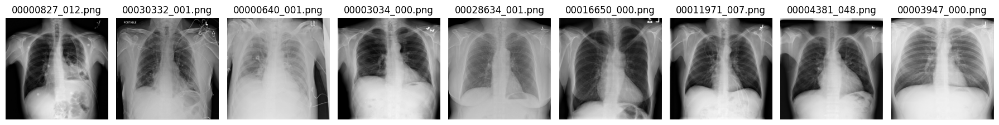

In [ ]:



# Seçeceğimiz rastgele görüntüleri kaydedeceğimiz klasör yolu
output_folder = "/content/random_images"

# Klasör varsa içindeki dosyaları sil, yoksa oluştur
if os.path.exists(output_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_folder)

# train_df DataFrame'inden rastgele 9 görüntü seçme
sample_images = random.sample(list(train_df['Image']), 9)

# Rastgele seçilen görüntüleri kaydetme ve görselleştirme
fig, axes = plt.subplots(1, 9, figsize=(18, 4))  # 9 görüntüyü yatay görselleştir

for idx, image_name in enumerate(sample_images):
    # Görüntüyü yükle
    img_path = f"/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/nih/images_small/{image_name}"
    img = io.imread(img_path)

    # Seçilen görüntüyü random_images klasörüne kaydetme
    save_path = os.path.join(output_folder, image_name)
    io.imsave(save_path, img)  # Görüntüyü kaydet

    # Görselleştirme
    axes[idx].imshow(img, cmap='gray')
    axes[idx].axis('off')
    axes[idx].set_title(image_name)

plt.tight_layout()
plt.show()


train_df içindeki "Image" sütunundan rastgele 9 görüntü seçilip random_images klasörüne kaydedilmesi.

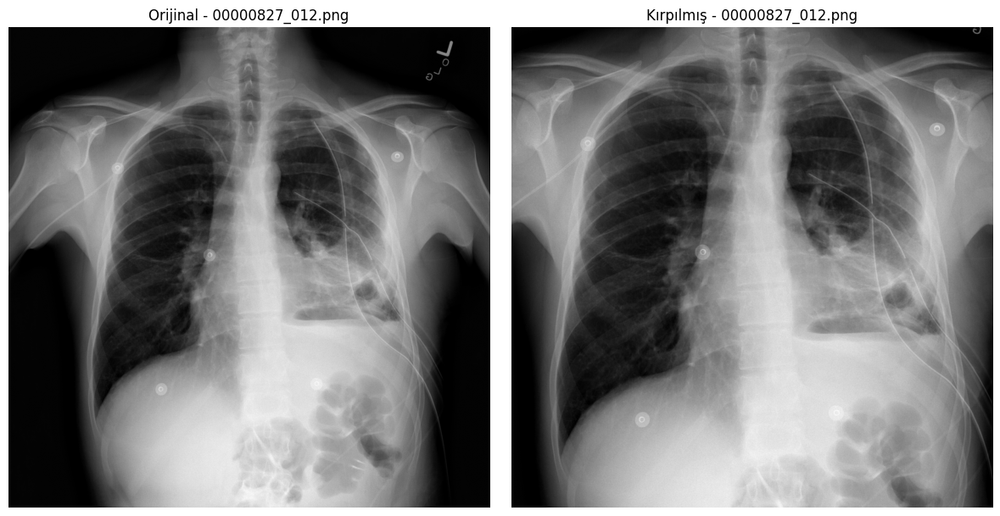

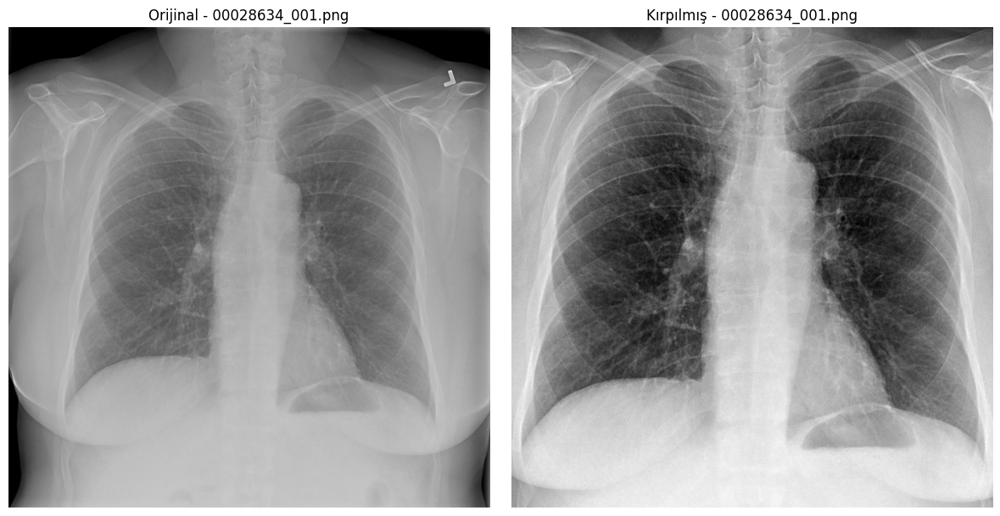

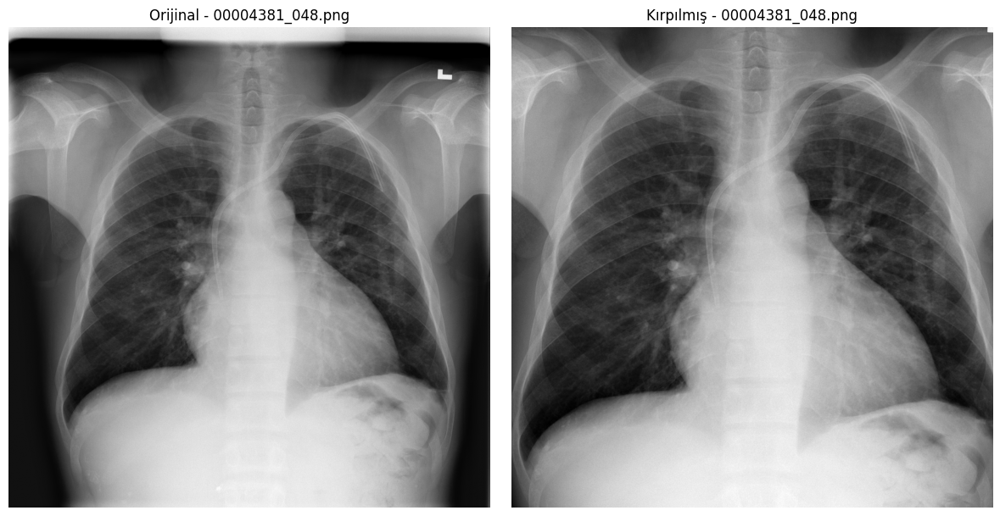

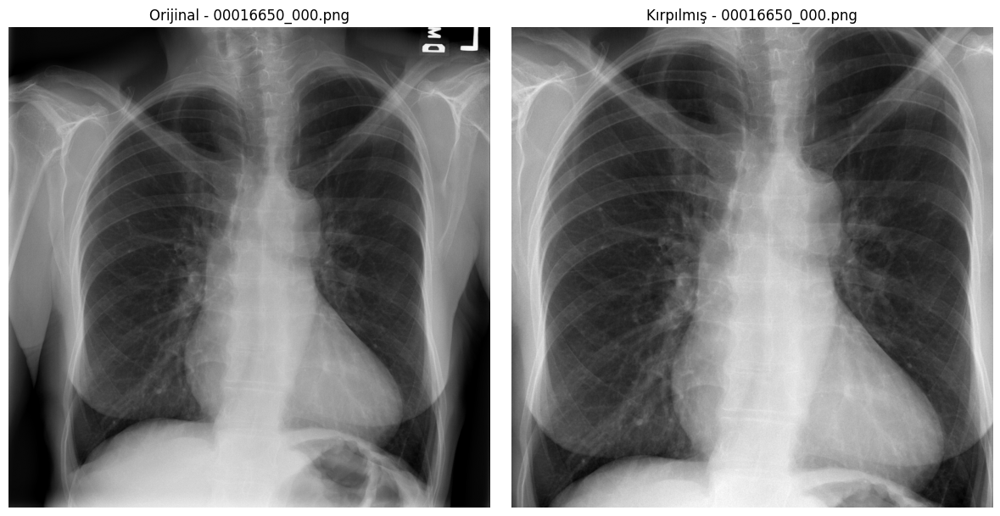

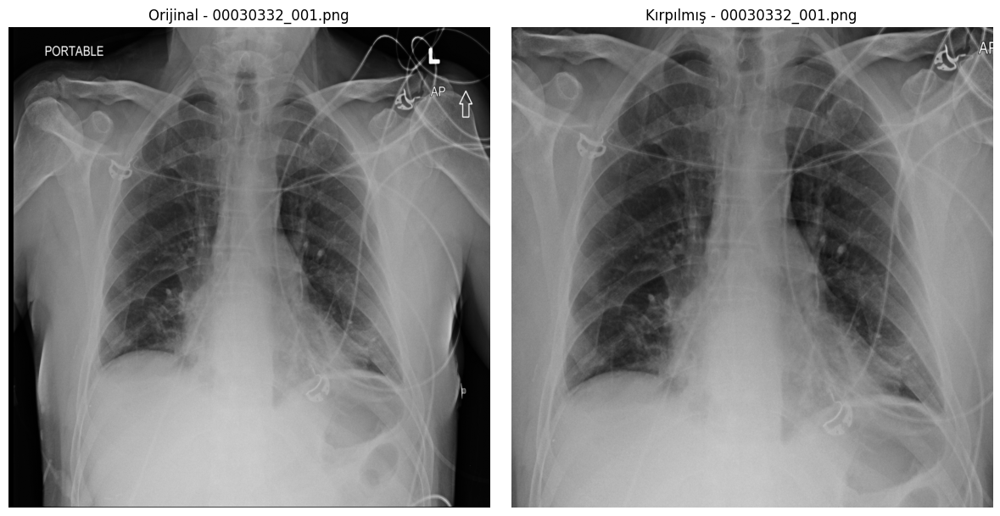

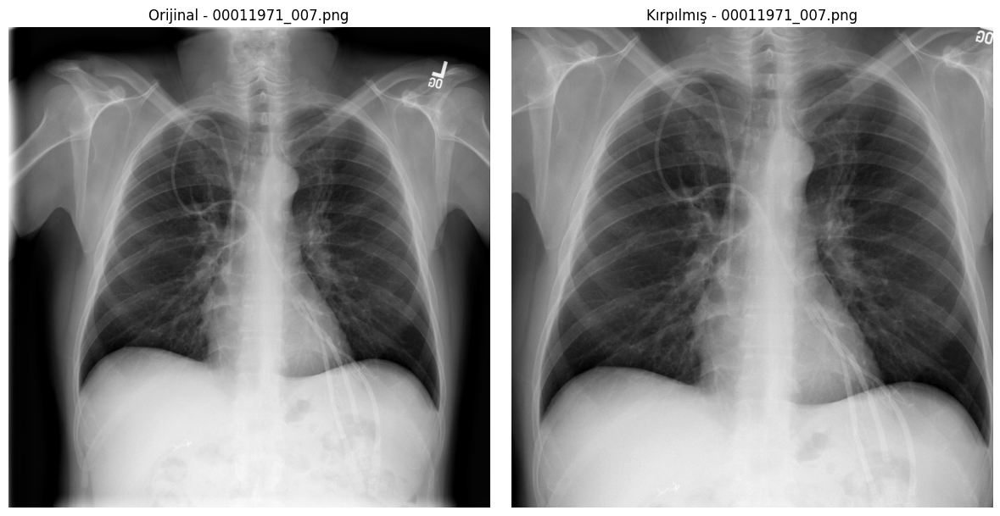

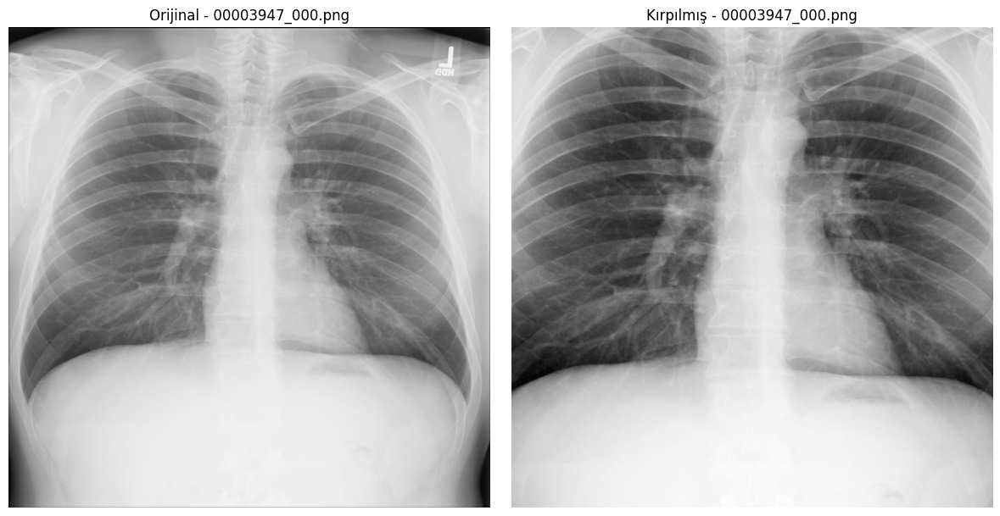

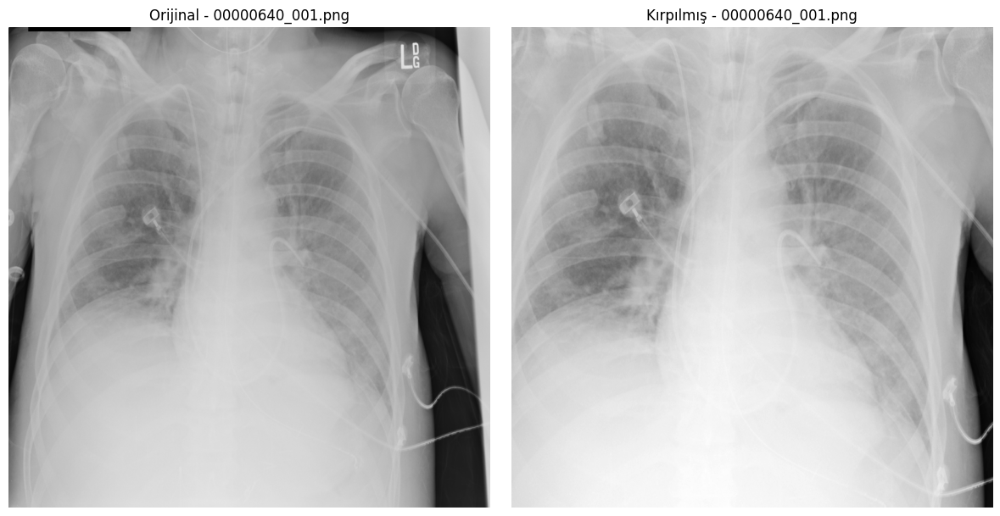

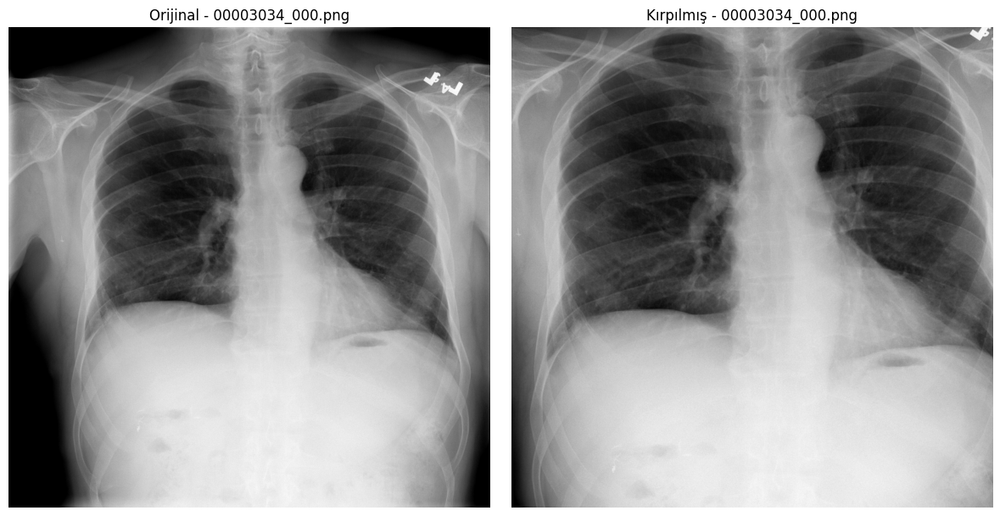

Kırpılmış görüntüler /content/cropping_images klasörüne kaydedildi.


In [ ]:

# Görüntü kırpma fonksiyonu
def crop_image(image, crop_fraction=0.1):
    h, w = image.shape[:2]
    crop_h, crop_w = int(h * crop_fraction), int(w * crop_fraction)
    return image[crop_h:h - crop_h, crop_w:w - crop_w]

# Klasör yolları
input_folder = "/content/random_images"  # Orijinal görüntülerin olduğu klasör
output_folder = "/content/cropping_images"  # Kırpılmış görüntülerin kaydedileceği klasör

if os.path.exists(output_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_folder)

# Klasördeki görüntüleri listele
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Her görüntü için kırpma işlemi ve kaydetme
for image_name in image_files:
    # Görüntüyü yükle
    img_path = os.path.join(input_folder, image_name)
    original_image = io.imread(img_path)

    # Görüntüyü kırp
    cropped_image = crop_image(original_image, crop_fraction=0.1)  # %10 oranında kırp

    # Kırpılmış görüntüyü kaydet
    save_path = os.path.join(output_folder, image_name)
    io.imsave(save_path, cropped_image)  # Kırpılmış görüntüyü kaydet

    # Orijinal ve kırpılmış görüntüyü görselleştir
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Orijinal görüntü
    axes[0].imshow(original_image, cmap='gray')
    axes[0].set_title(f"Orijinal - {image_name}")
    axes[0].axis('off')

    # Kırpılmış görüntü
    axes[1].imshow(cropped_image, cmap='gray')
    axes[1].set_title(f"Kırpılmış - {image_name}")
    axes[1].axis('off')

    plt.tight_layout()
    plt.show()

print(f"Kırpılmış görüntüler {output_folder} klasörüne kaydedildi.")


Görüntülerin Akciğer bölgeleri kaybolmayacak şekilde kenarlardan kırpılması. (Kırpılan görüntüler cropping_images klasörüne kaydedilir.)

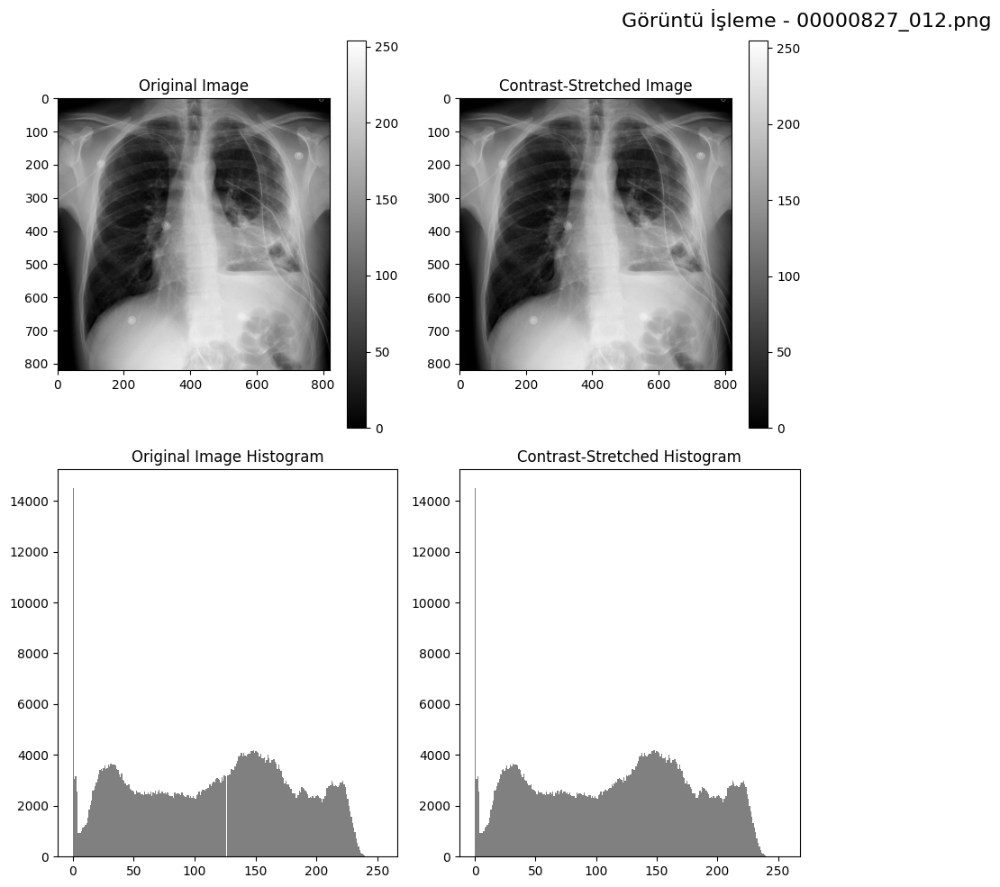

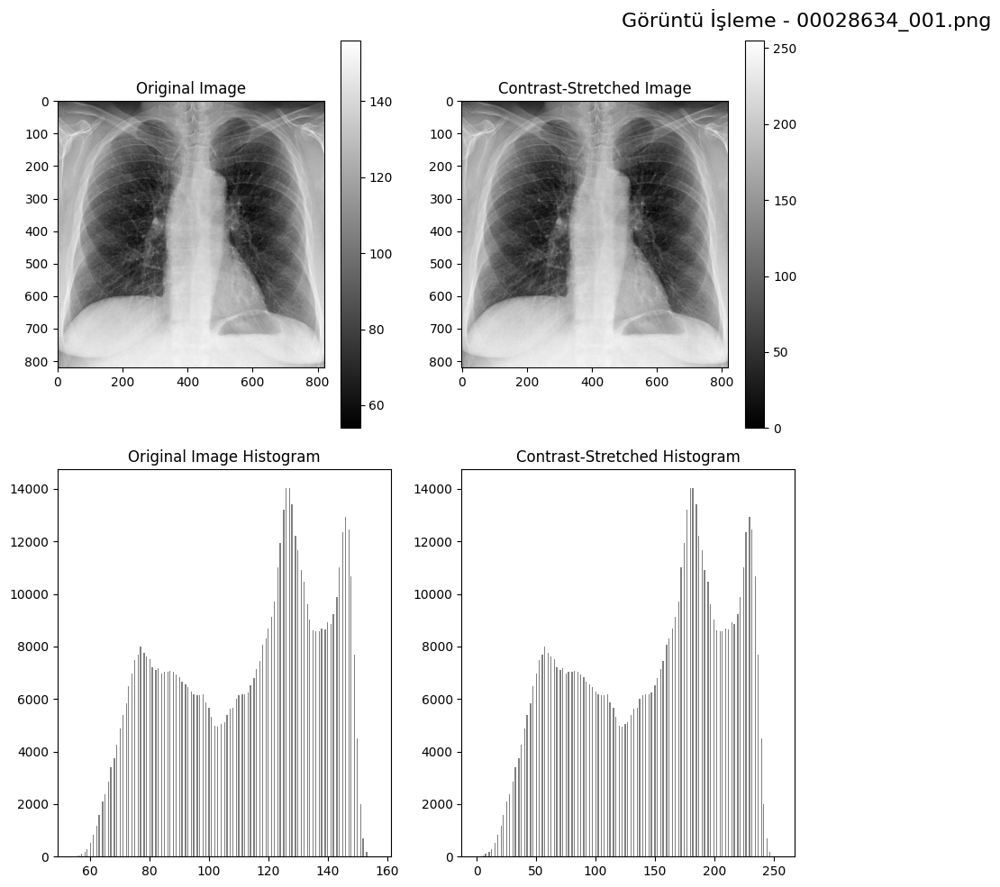

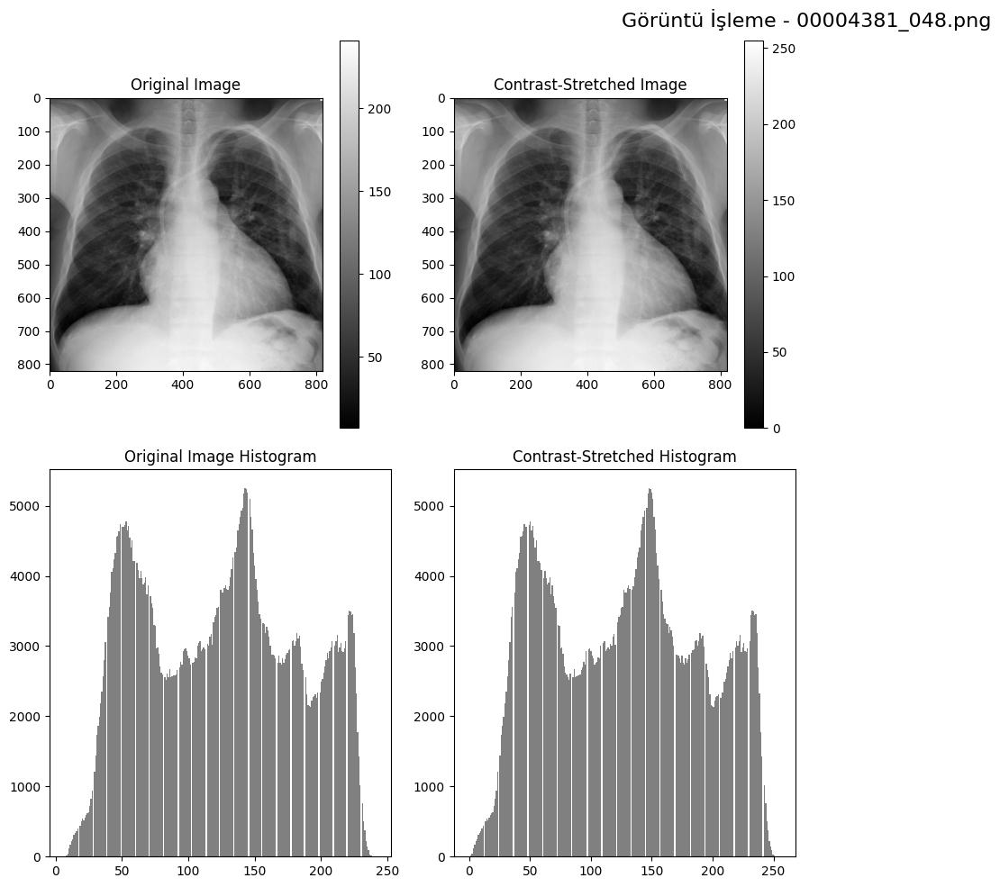

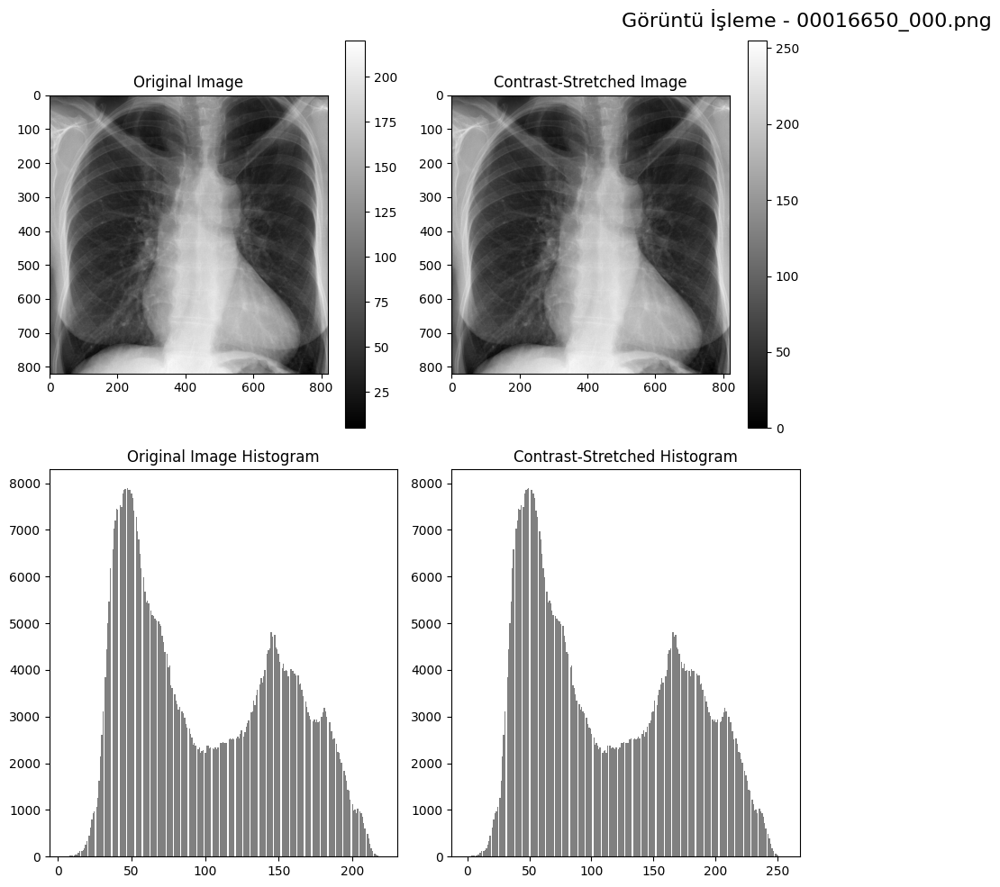

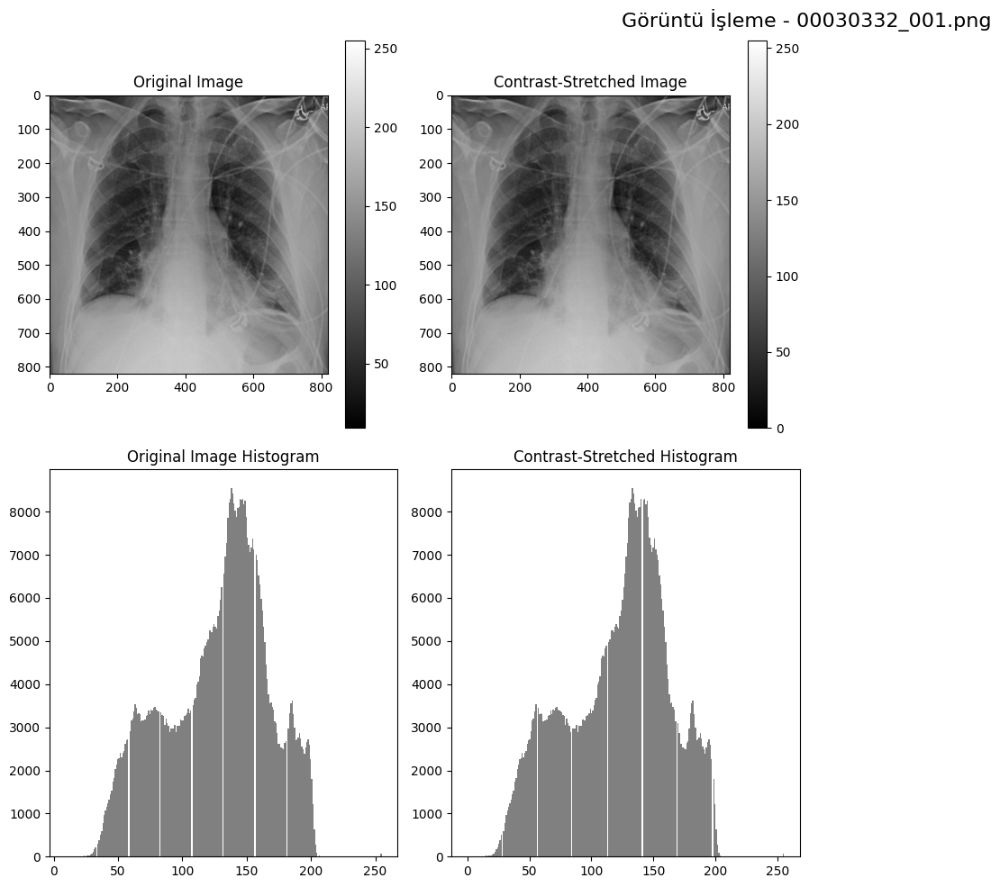

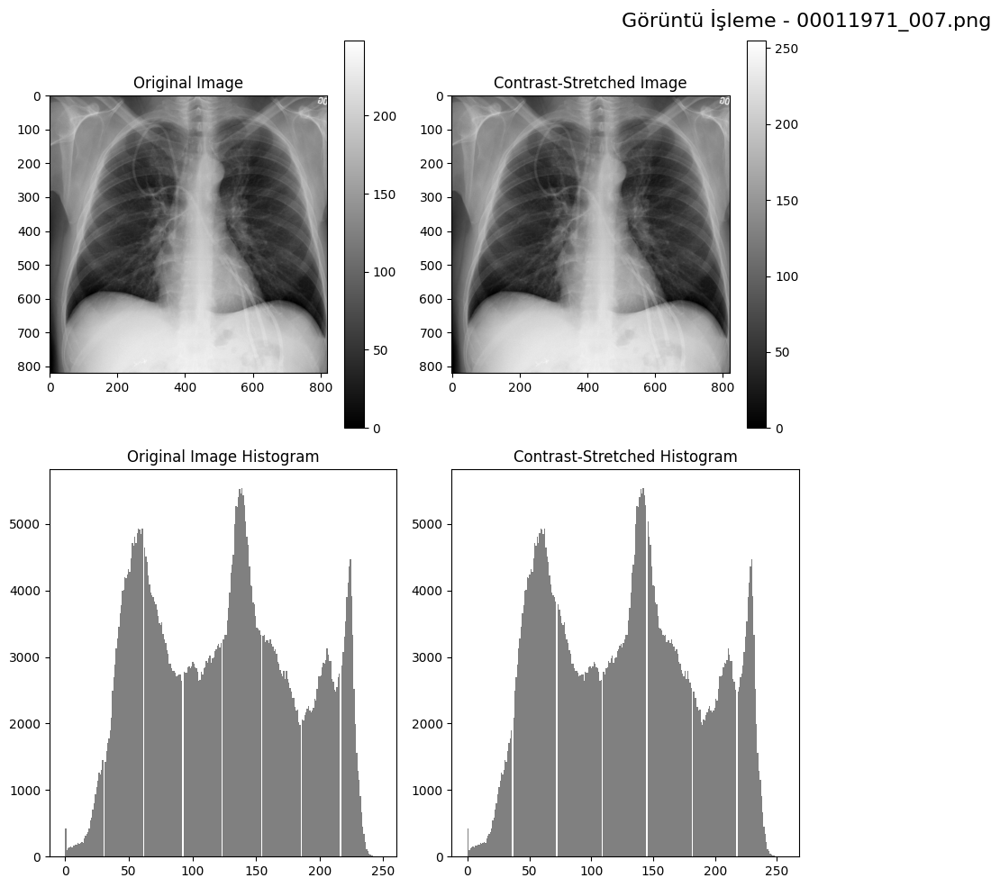

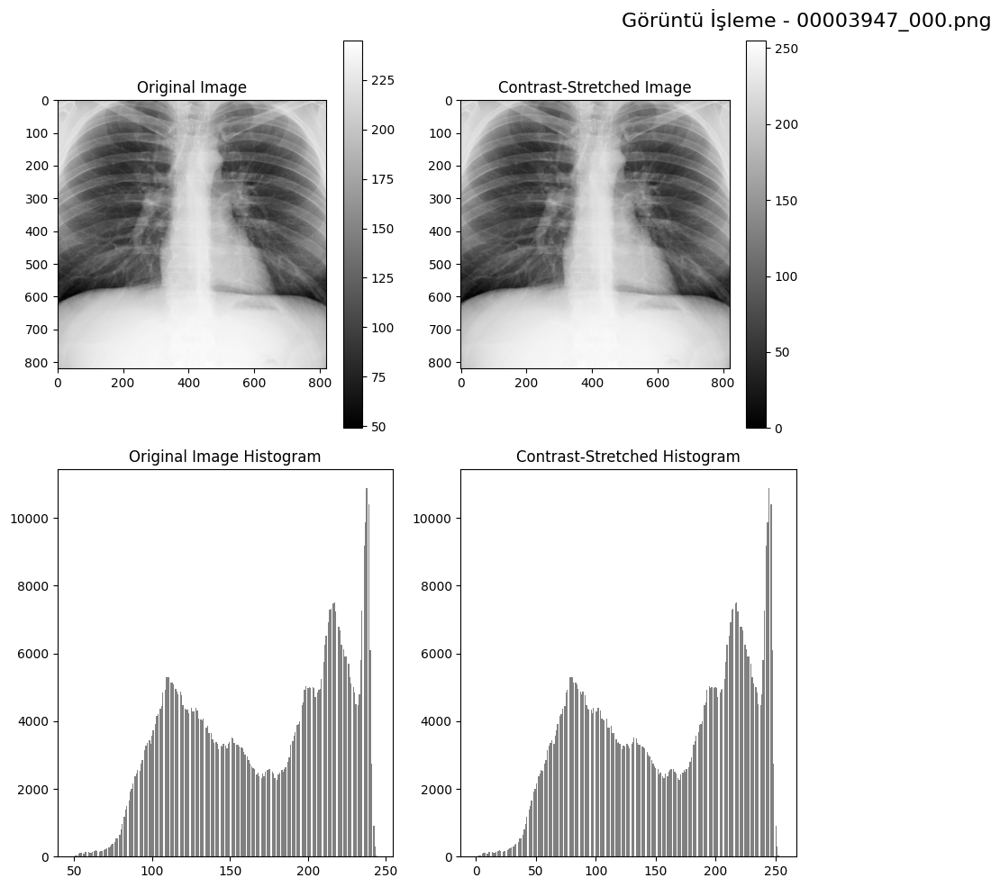

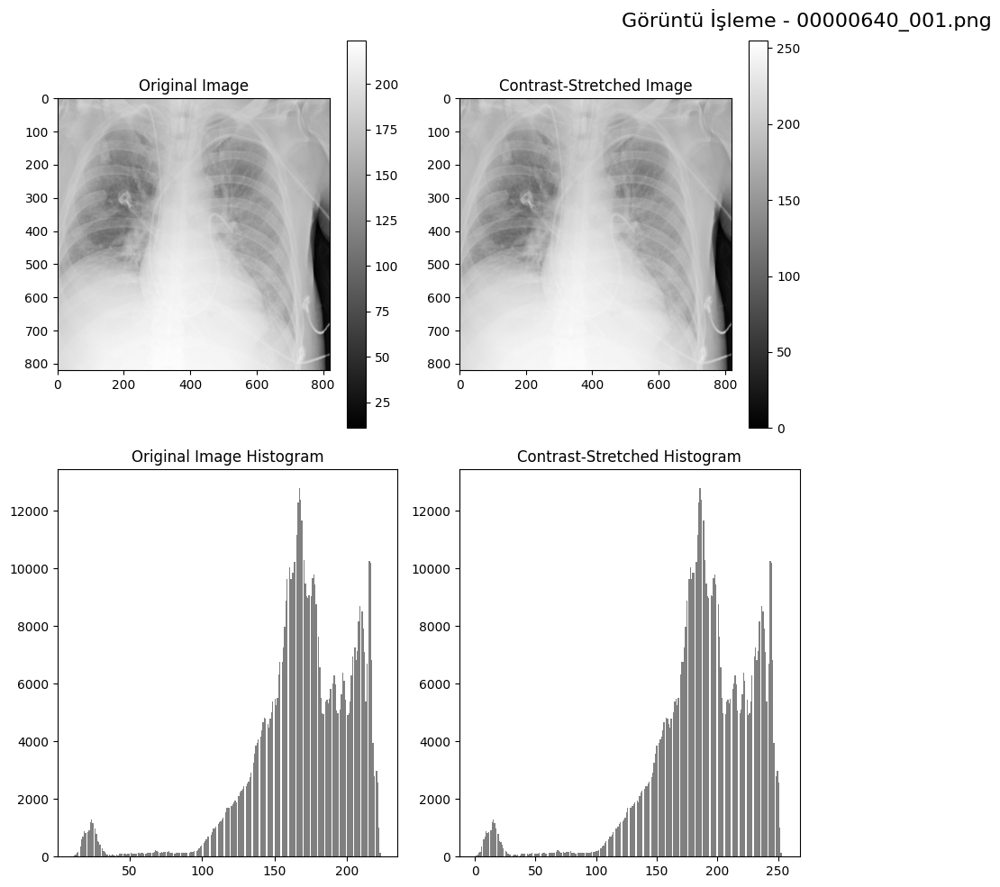

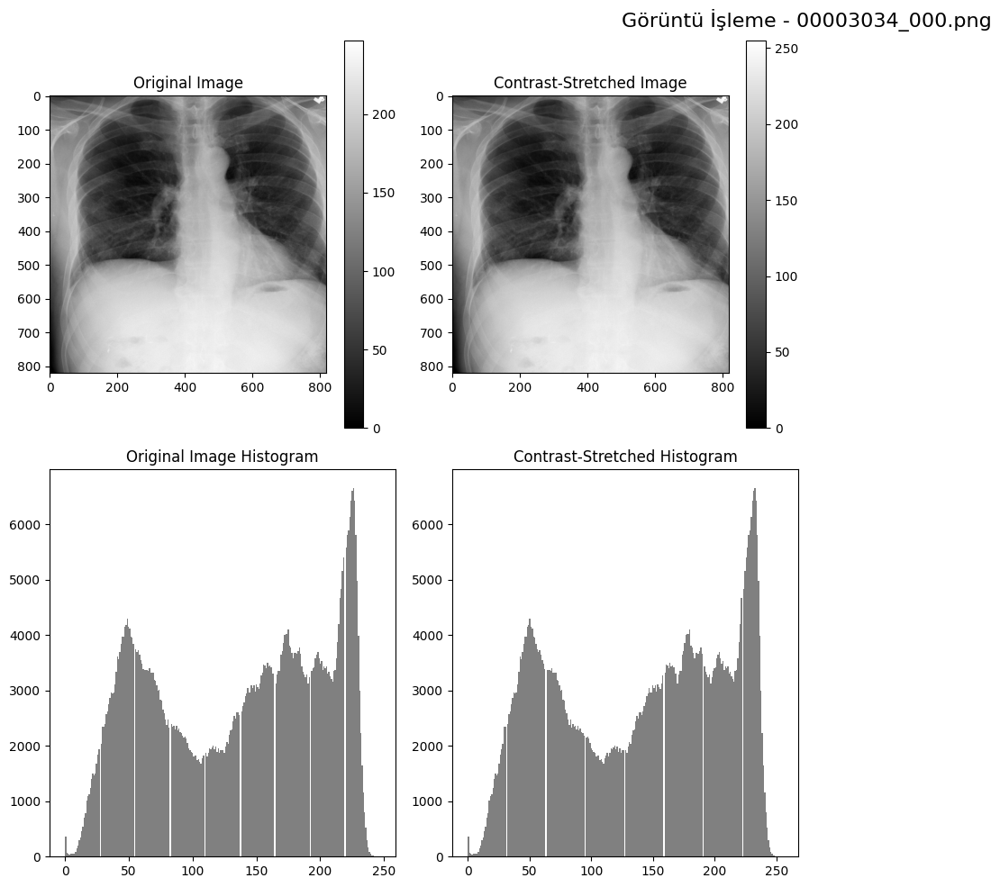

In [ ]:


input_folder = "/content/cropping_images" # İşlem yapılacak klasör
output_folder = "/content/streching_images"  # Kontrast gerilmiş görüntülerin kaydedileceği klasör

# Klasördeki tüm görüntüleri listeleme
image_files = os.listdir(input_folder)

# Eğer çıktı klasörü yoksa oluştur
if os.path.exists(output_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_folder)

for image_name in image_files:
    # Görüntü yükleme
    image_path = os.path.join(input_folder, image_name)
    raw_image = io.imread(image_path)

    # Minimum ve maksimum hesaplama, kontrast germe işlemi uygulama
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # görüntüyü kaydetme
    output_image_path = os.path.join(output_folder, f"streched_{image_name}")
    io.imsave(output_image_path, contrast_stretched)



    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Görüntü İşleme - {image_name}", fontsize=16)

    # Orijinal görüntü ve histogramı
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast gerilmiş görüntü ve histogramı
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")


    plt.tight_layout()
    plt.show()

Kırpılmış görüntülerin Kontrast Germe (Stretching) işlemi. (Çıktı görüntüler streching_images klasörüne kaydedilir.)

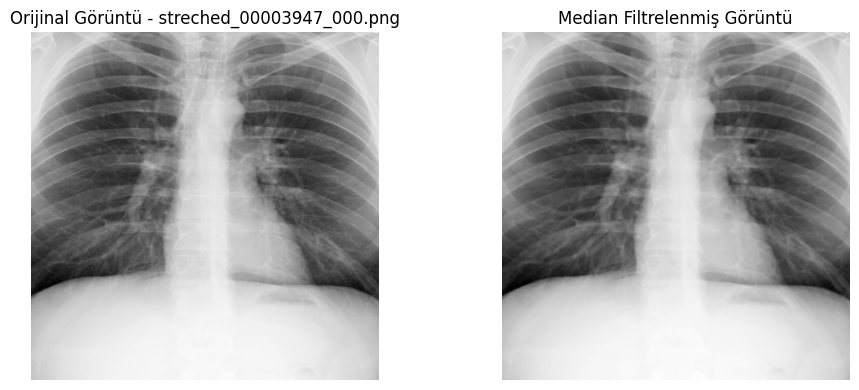

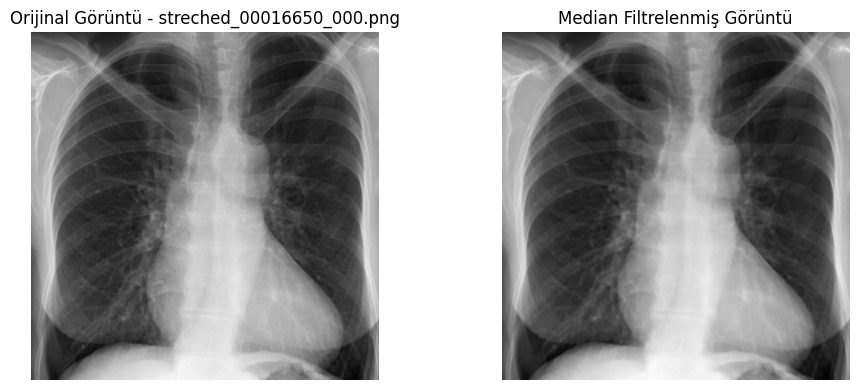

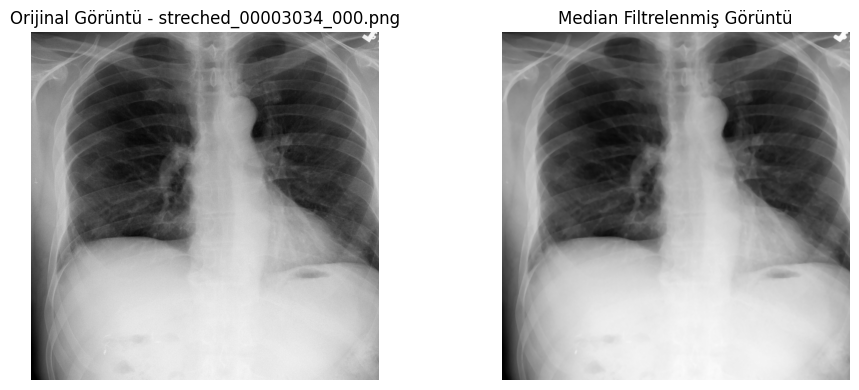

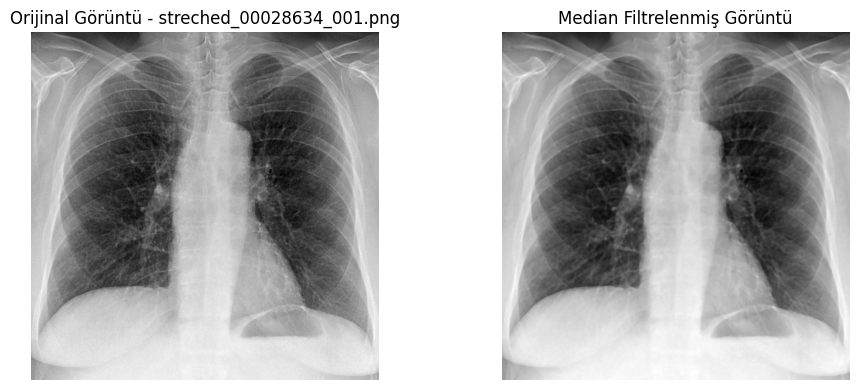

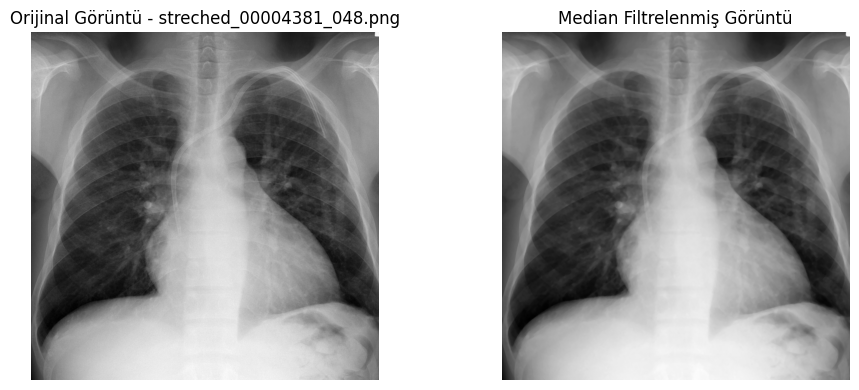

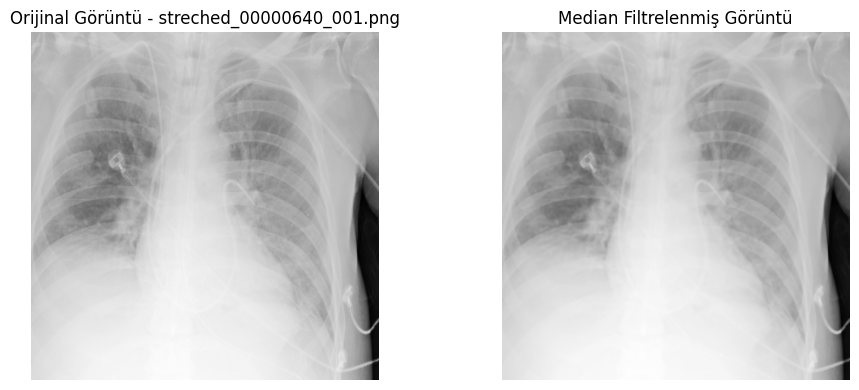

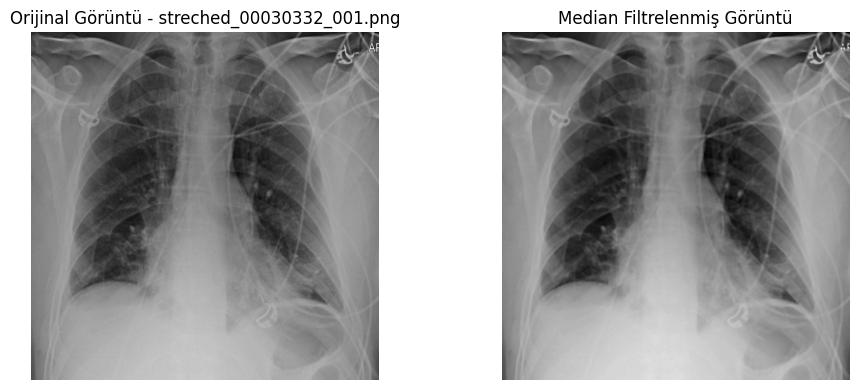

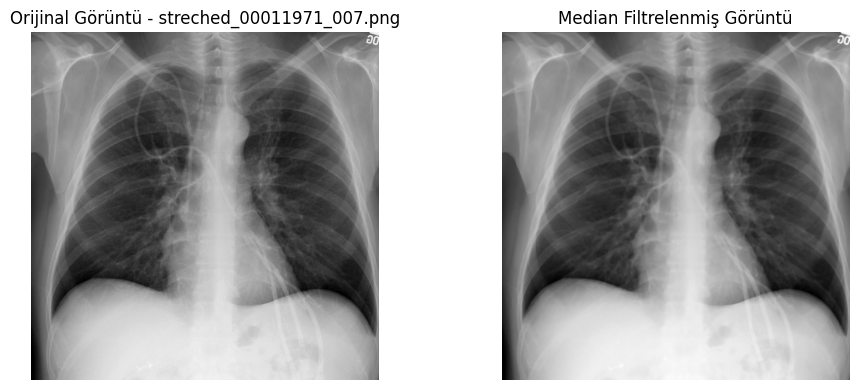

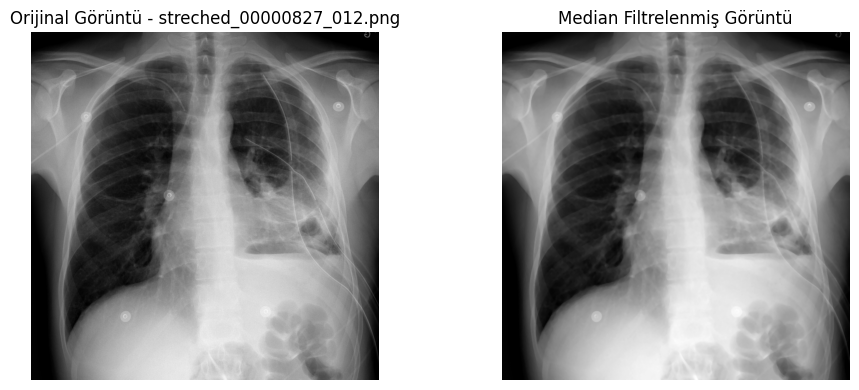

Tüm median filtrelenmiş görüntüler /content/median-filtering_images klasörüne kaydedildi.


In [ ]:
# İşlem yapılacak ve kaydedilecek klasörler
input_folder = "/content/streching_images"  # Giriş klasörü
output_folder = "/content/median-filtering_images"  # Çıkış klasörü

# Klasördeki tüm görüntüleri listeleme
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Eğer çıktı klasörü yoksa oluştur
if os.path.exists(output_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_folder)

for image_name in image_files:
    # Görüntüyü yükleme
    image_path = os.path.join(input_folder, image_name)
    raw_image = io.imread(image_path)

    # Median Filtering işlemi
    median_filtered = cv2.medianBlur(raw_image, 5)

    # Görüntüyü kaydetme
    output_image_path = os.path.join(output_folder, f"median-filtered_{image_name}")
    io.imsave(output_image_path, median_filtered)

    # Sonuçları görselleştirme
    plt.figure(figsize=(10, 4))

    # Orijinal görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title(f"Orijinal Görüntü - {image_name}")
    plt.axis("off")

    # Median filtrelenmiş görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(median_filtered, cmap='gray')
    plt.title("Median Filtrelenmiş Görüntü")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

print(f"Tüm median filtrelenmiş görüntüler {output_folder} klasörüne kaydedildi.")

streching_images içindeki görüntülere Median filtre uygulanması. (Medyan filtrelenmiş görüntüler median-filtering_images klasörüne kaydedilir.)

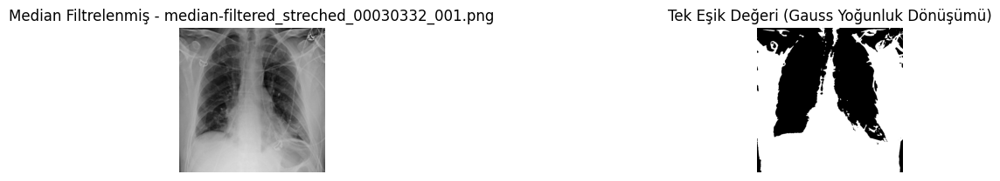

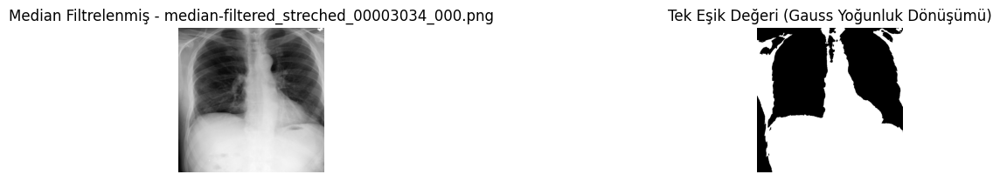

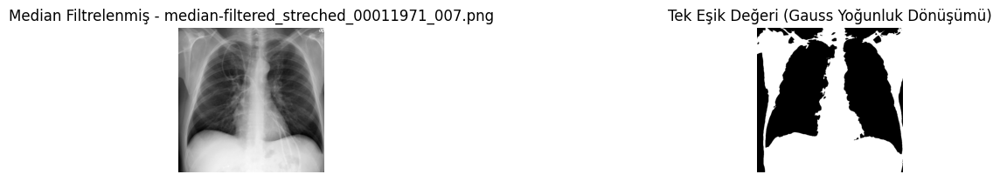

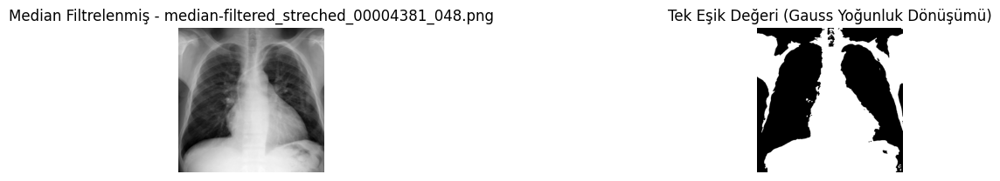

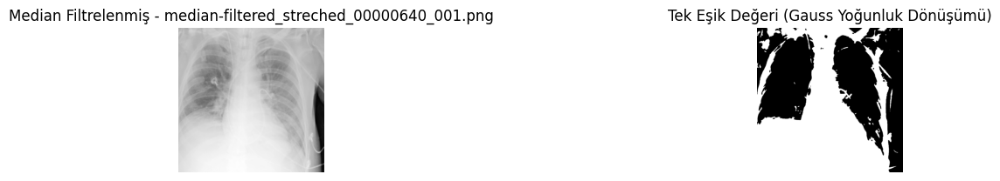

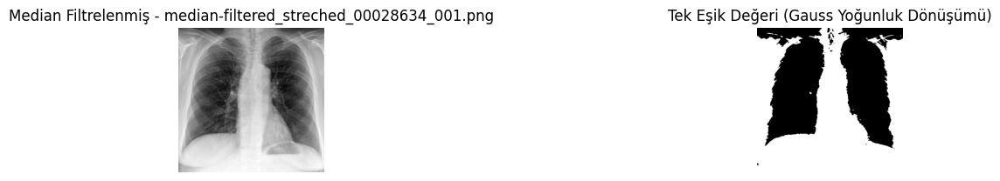

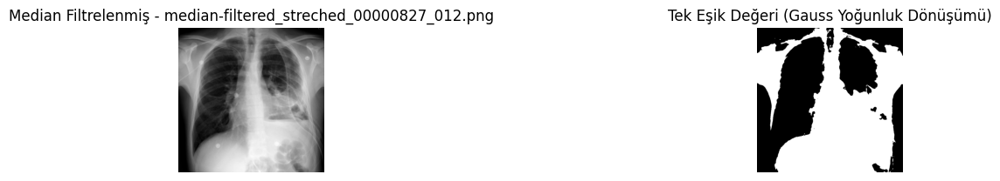

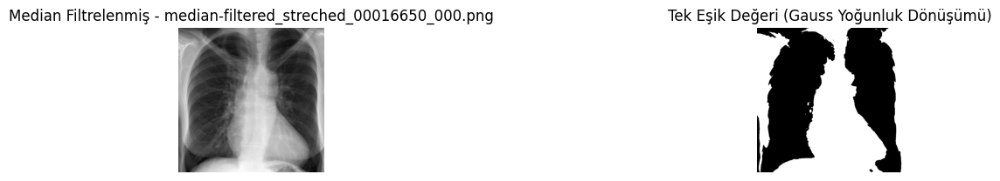

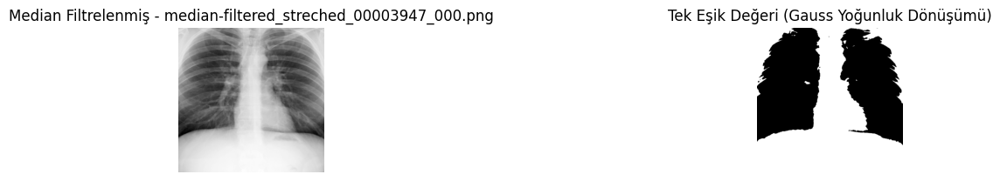

In [ ]:

# Median filtrelenmiş görüntülerin olduğu klasör yolu
input_folder = "/content/median-filtering_images"

# Klasördeki tüm görüntü dosyalarını okuma
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Her bir görüntü üzerinde eşik belirleme işlemleri uygulama
for image_file in image_files:
    # Görüntüyü yükleme
    img_path = os.path.join(input_folder, image_file)
    median_filtered = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

    # Tek eşik değeri ile Gauss yoğunluk dönüşümü
    gauss_transformed = cv2.GaussianBlur(median_filtered, (5, 5), 0)
    single_threshold = np.mean(gauss_transformed)  # Ortalama yoğunluk değeri
    binary_single_threshold = (gauss_transformed > single_threshold).astype(np.uint8) * 255

    # Sonuçları görselleştirme
    plt.figure(figsize=(20, 4))

    # Median filtrelenmiş görüntü
    plt.subplot(2, 3, 1)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(f"Median Filtrelenmiş - {image_file}")
    plt.axis("off")

    # Gauss yoğunluk dönüşümü ve tek eşik
    plt.subplot(2, 3, 2)
    plt.imshow(binary_single_threshold, cmap='gray')
    plt.title("Tek Eşik Değeri (Gauss Yoğunluk Dönüşümü)")
    plt.axis("off")

    plt.tight_layout()
    plt.show()



Median filtrelenmiş görüntülerin üzerine Gauss Yoğunluk Dönüşümü uygulanması.

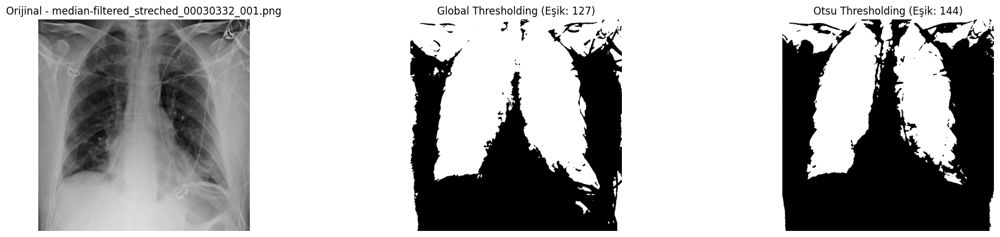

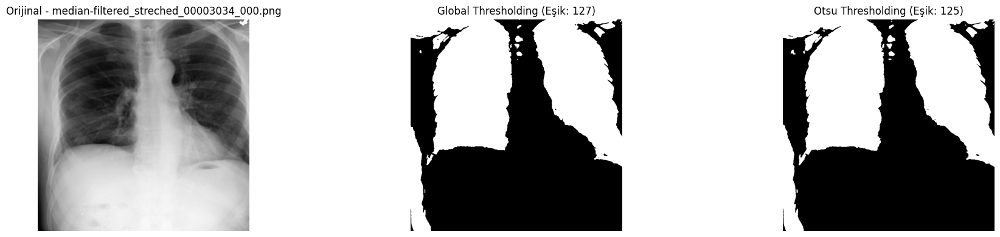

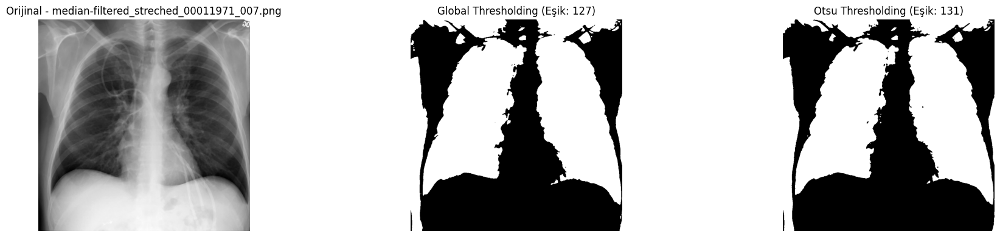

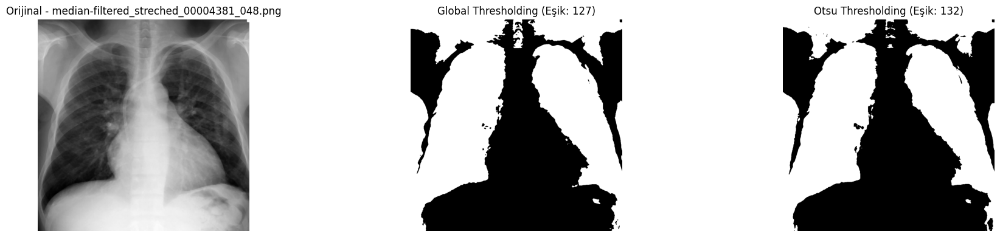

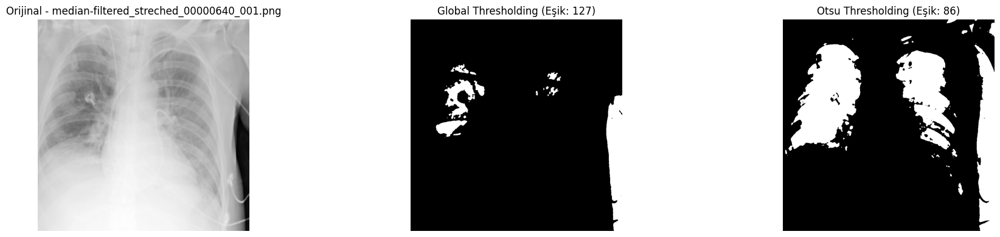

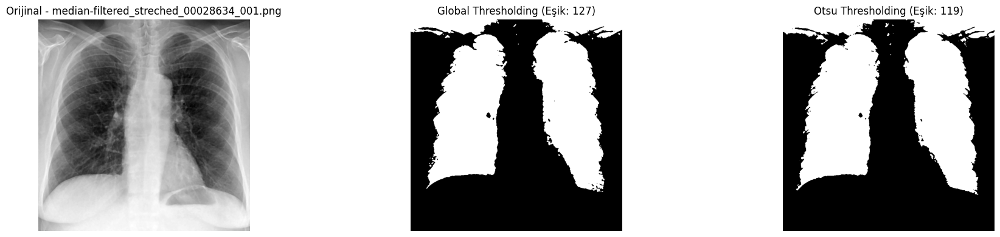

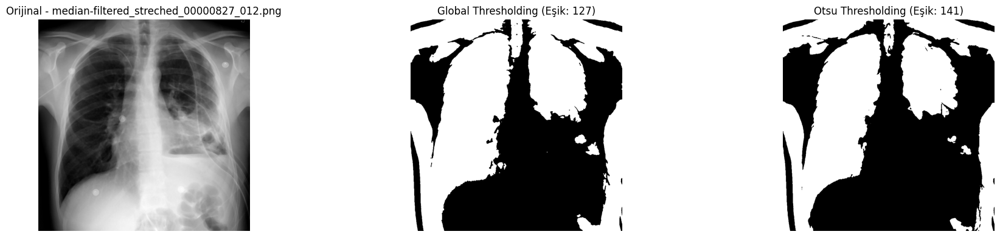

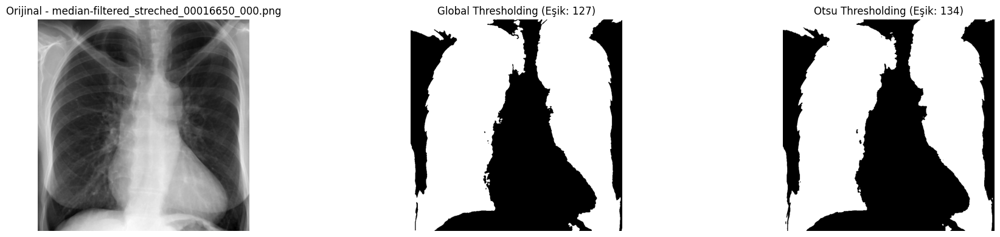

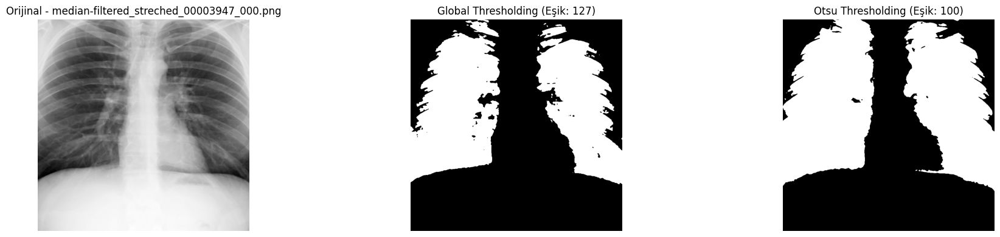

In [ ]:
# İşlem yapılacak median filtrelenmiş görüntülerin olduğu klasör
input_folder = "/content/median-filtering_images"

# Klasördeki tüm görüntüleri listeleme
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Her bir görüntüye thresholding işlemleri uygula
for image_name in image_files:
    # Görüntüyü yükleme
    image_path = os.path.join(input_folder, image_name)
    median_filtered = io.imread(image_path, as_gray=True)  # Gri tonlama olarak yükle

    # Global thresholding
    global_thresh_value = 127  # Sabit bir eşik değeri
    _, global_thresh = cv2.threshold((median_filtered * 255).astype('uint8'), global_thresh_value, 255, cv2.THRESH_BINARY)

    # Otsu thresholding
    _, otsu_thresh = cv2.threshold((median_filtered * 255).astype('uint8'), 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Görselleştirme
    plt.figure(figsize=(20, 4))

    # Orijinal görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(median_filtered, cmap='gray')
    plt.title(f"Orijinal - {image_name}")
    plt.axis("off")

    # Global threshold
    plt.subplot(1, 3, 2)
    plt.imshow(global_thresh, cmap='gray')
    plt.title(f"Global Thresholding (Eşik: {global_thresh_value})")
    plt.axis("off")

    # Otsu threshold
    plt.subplot(1, 3, 3)
    plt.imshow(otsu_thresh, cmap='gray')
    plt.title(f"Otsu Thresholding (Eşik: {int(_):d})")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

Median filtrelenmiş görüntülerin üzerine Global ve Otsu eşik değeri belirlenip uygulanması.


İşleniyor: 00000827_012.png
Bağlantı bileşen analizi sonucunda toplam 4 bölge bulundu.

Bölge Özellikleri (00000827_012.png):
Bölge 1:
  Area: 375512.0
  Centroid: (470.0114457061292, 457.01747214469844)
  Eccentricity: 0.40384905295713097
  Perimeter: 9802.155405745045
  Mean Intensity: 166.52312575896377
Bölge 2:
  Area: 132.0
  Centroid: (122.92424242424242, 560.4318181818181)
  Eccentricity: 0.9990743603483294
  Perimeter: 109.18376618407356
  Mean Intensity: 122.68939393939394
Bölge 3:
  Area: 120.0
  Centroid: (271.5, 610.9333333333333)
  Eccentricity: 0.9993837508872183
  Perimeter: 106.82842712474618
  Mean Intensity: 121.35833333333333
Bölge 4:
  Area: 188.0
  Centroid: (659.9308510638298, 73.75531914893617)
  Eccentricity: 0.9916216170530929
  Perimeter: 106.59188309203678
  Mean Intensity: 113.93617021276596


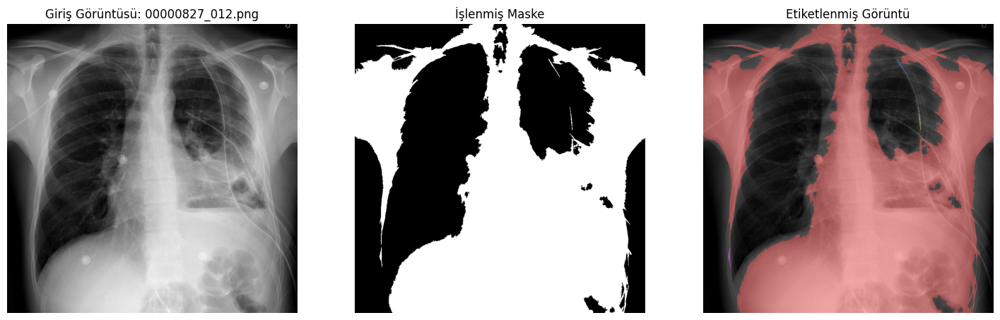

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00000827_012.png
Seçilen Label: 1, Alan: 375512.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00000827_012.png

İşleniyor: 00028634_001.png
Bağlantı bileşen analizi sonucunda toplam 4 bölge bulundu.

Bölge Özellikleri (00028634_001.png):
Bölge 1:
  Area: 398421.0
  Centroid: (479.31650440112344, 406.59265199374533)
  Eccentricity: 0.2181742314220685
  Perimeter: 10596.604107192825
  Mean Intensity: 130.74051317576132
Bölge 2:
  Area: 211.0
  Centroid: (370.93838862559244, 300.6729857819905)
  Eccentricity: 0.622401247305964
  Perimeter: 57.112698372208094
  Mean Intensity: 113.77725118483413
Bölge 3:
  Area: 52.0
  Centroid: (390.0769230769231, 535.9423076923077)
  Eccentricity: 0.9156152327636846
  Perimeter: 29.14213562373095
  Mean Intensity: 112.63461538461539
Bölge 4:
  Area: 86.0
  Centroid: (467.2093023255814, 540.1162790697674)
  Eccentricity: 0.5717484349353437
  Perimeter: 46.798989873223334

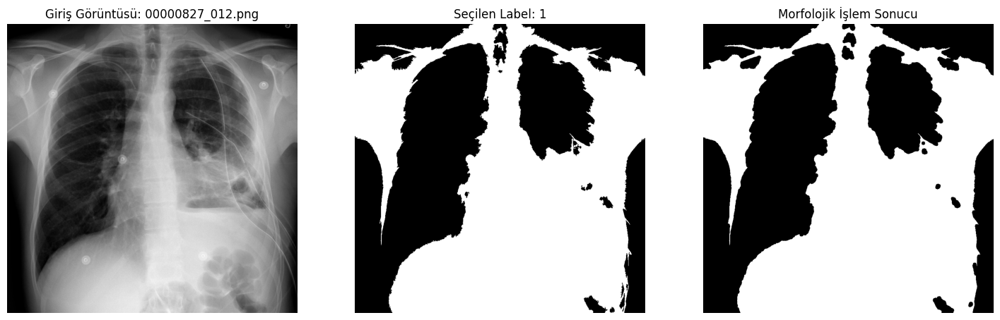

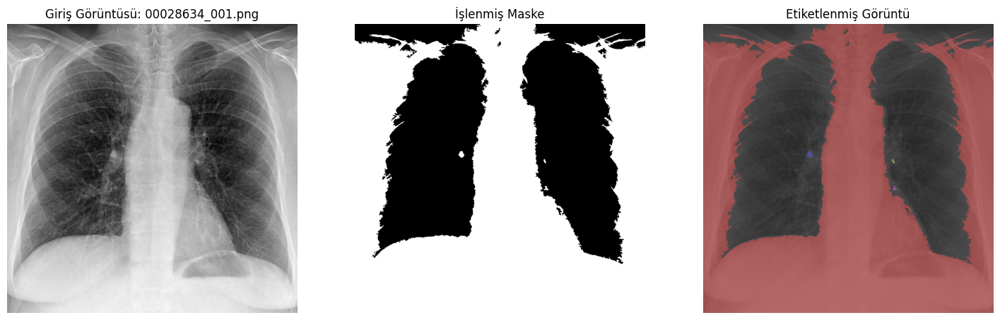

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00028634_001.png
Seçilen Label: 1, Alan: 398421.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00028634_001.png

İşleniyor: 00004381_048.png
Bağlantı bileşen analizi sonucunda toplam 6 bölge bulundu.

Bölge Özellikleri (00004381_048.png):
Bölge 1:
  Area: 313271.0
  Centroid: (506.26521446287717, 484.40223640234814)
  Eccentricity: 0.7441667605347121
  Perimeter: 7524.849527004026
  Mean Intensity: 174.37387437713673
Bölge 2:
  Area: 109.0
  Centroid: (4.954128440366972, 814.5412844036697)
  Eccentricity: 0.4233615100581333
  Perimeter: 37.41421356237309
  Mean Intensity: 224.67889908256882
Bölge 3:
  Area: 43028.0
  Centroid: (211.66347494654644, 73.75732081435345)
  Eccentricity: 0.911359484603745
  Perimeter: 2174.7301935711603
  Mean Intensity: 145.993701775588
Bölge 4:
  Area: 440.0
  Centroid: (415.11136363636365, 291.4159090909091)
  Eccentricity: 0.9209389845228274
  Perimeter: 164.817279836452

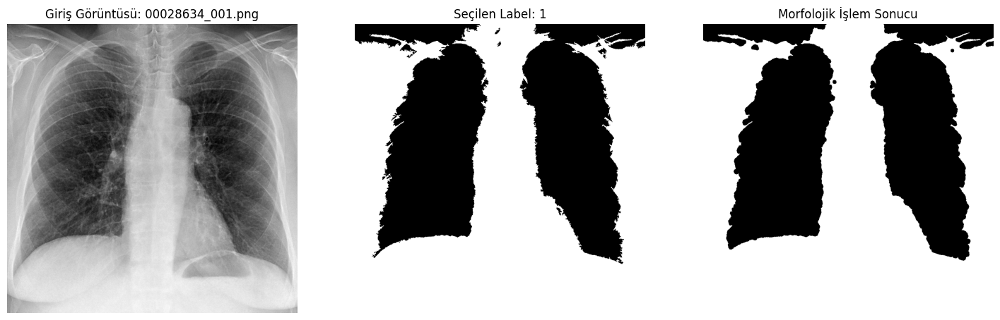

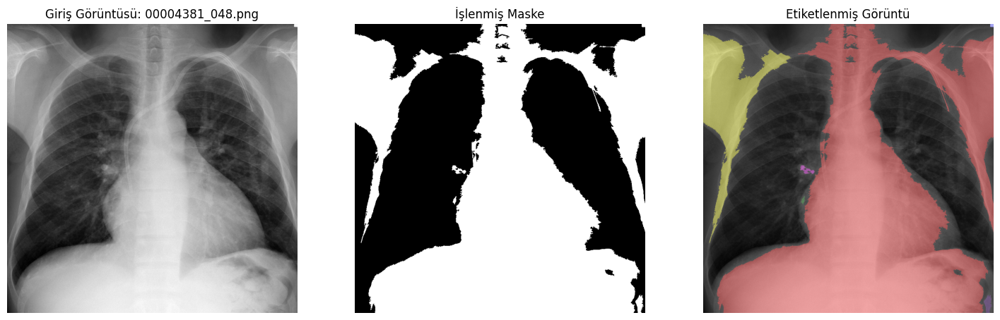

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00004381_048.png
Seçilen Label: 1, Alan: 313271.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00004381_048.png

İşleniyor: 00016650_000.png
Bağlantı bileşen analizi sonucunda toplam 5 bölge bulundu.

Bölge Özellikleri (00016650_000.png):
Bölge 1:
  Area: 208820.0
  Centroid: (533.3823532228714, 453.57389138971365)
  Eccentricity: 0.8621290632101593
  Perimeter: 4314.400466618748
  Mean Intensity: 156.97052485394119
Bölge 2:
  Area: 39296.0
  Centroid: (297.57217019543975, 787.7537408387623)
  Eccentricity: 0.9948602783691547
  Perimeter: 2109.395057047366
  Mean Intensity: 147.57061787459284
Bölge 3:
  Area: 51171.0
  Centroid: (299.4106036622306, 49.44888706493913)
  Eccentricity: 0.985351100256232
  Perimeter: 2614.0977259393076
  Mean Intensity: 146.66158566375486
Bölge 4:
  Area: 98.0
  Centroid: (433.765306122449, 286.8775510204082)
  Eccentricity: 0.9132004312428441
  Perimeter: 48.2132034355964

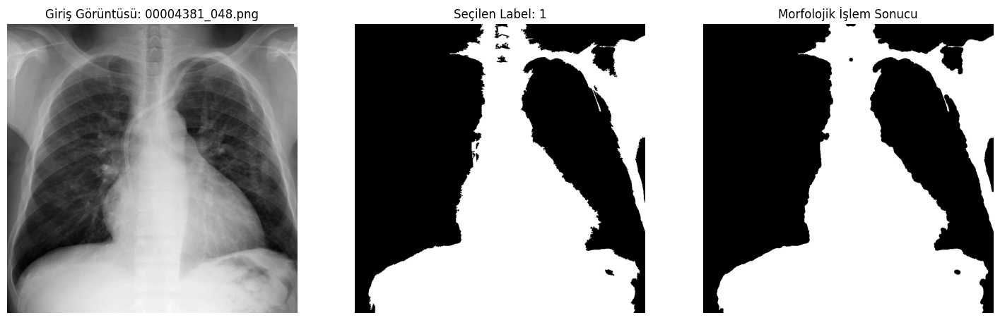

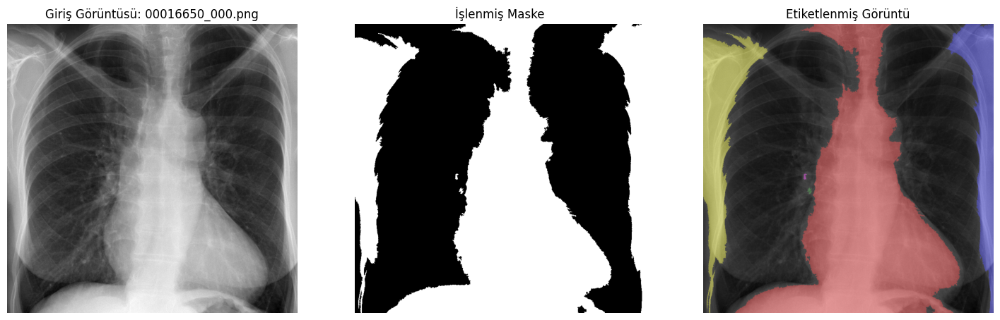

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00016650_000.png
Seçilen Label: 1, Alan: 208820.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00016650_000.png

İşleniyor: 00030332_001.png
Bağlantı bileşen analizi sonucunda toplam 13 bölge bulundu.

Bölge Özellikleri (00030332_001.png):
Bölge 1:
  Area: 434355.0
  Centroid: (485.97716844516583, 424.3660369973869)
  Eccentricity: 0.45063216543854734
  Perimeter: 13538.488809165287
  Mean Intensity: 151.9124702144559
Bölge 2:
  Area: 114.0
  Centroid: (9.192982456140351, 806.5087719298245)
  Eccentricity: 0.7988720147997006
  Perimeter: 75.34924240491749
  Mean Intensity: 142.31578947368422
Bölge 3:
  Area: 67.0
  Centroid: (20.686567164179106, 784.6119402985074)
  Eccentricity: 0.9840433512418116
  Perimeter: 49.04163056034261
  Mean Intensity: 131.82089552238807
Bölge 4:
  Area: 139.0
  Centroid: (36.46762589928058, 802.7482014388489)
  Eccentricity: 0.7252210892040187
  Perimeter: 63.62741699796952

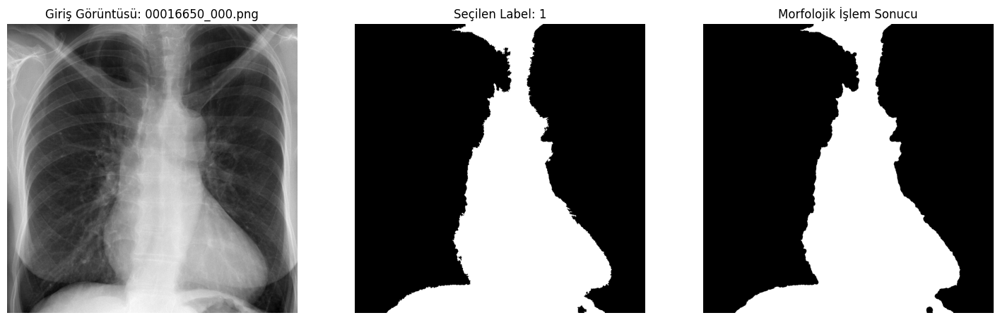

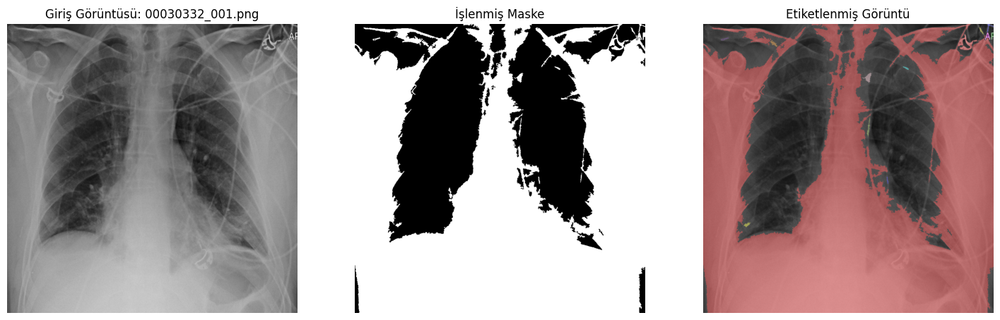

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00030332_001.png
Seçilen Label: 1, Alan: 434355.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00030332_001.png

İşleniyor: 00011971_007.png
Bağlantı bileşen analizi sonucunda toplam 3 bölge bulundu.

Bölge Özellikleri (00011971_007.png):
Bölge 1:
  Area: 354407.0
  Centroid: (463.774036630202, 412.57914770306456)
  Eccentricity: 0.4854933092116854
  Perimeter: 10709.300679430356
  Mean Intensity: 171.4511169361779
Bölge 2:
  Area: 68.0
  Centroid: (150.85294117647058, 403.1764705882353)
  Eccentricity: 0.8198740704836593
  Perimeter: 56.834523779156065
  Mean Intensity: 124.67647058823529
Bölge 3:
  Area: 52.0
  Centroid: (398.6923076923077, 327.9807692307692)
  Eccentricity: 0.9330502166531631
  Perimeter: 32.3492424049175
  Mean Intensity: 124.86538461538461


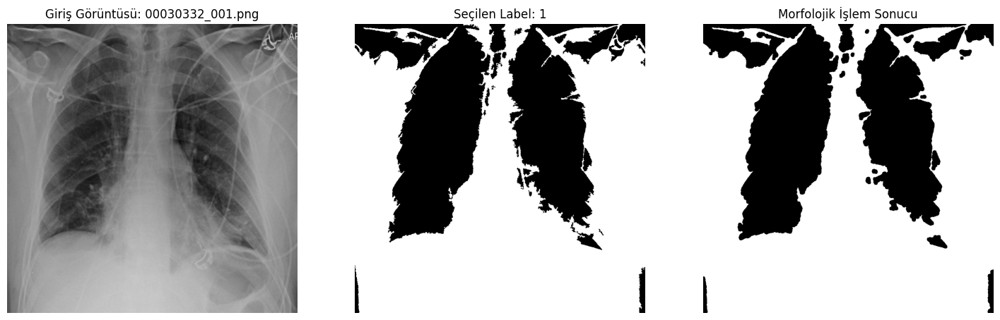

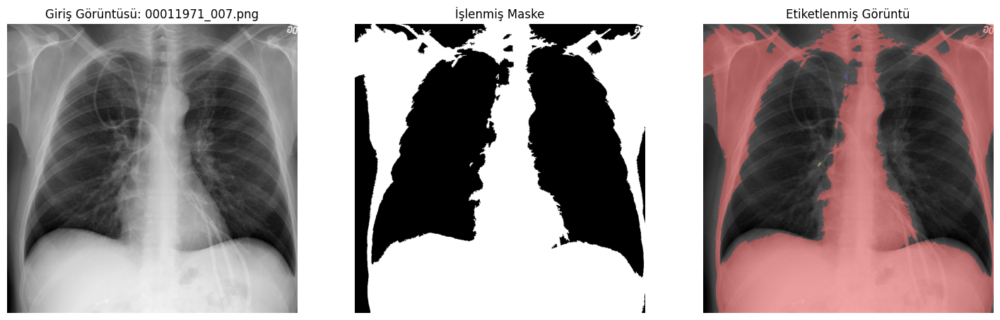

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00011971_007.png
Seçilen Label: 1, Alan: 354407.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00011971_007.png

İşleniyor: 00003947_000.png
Bağlantı bileşen analizi sonucunda toplam 8 bölge bulundu.

Bölge Özellikleri (00003947_000.png):
Bölge 1:
  Area: 27521.0
  Centroid: (105.6051378946986, 60.48221358235529)
  Eccentricity: 0.9047981813228974
  Perimeter: 1616.9341622907673
  Mean Intensity: 201.296827876894
Bölge 2:
  Area: 328015.0
  Centroid: (519.5578952182065, 449.93171044007136)
  Eccentricity: 0.7175834620045854
  Perimeter: 6760.600610193747
  Mean Intensity: 212.88968187430453
Bölge 3:
  Area: 198.0
  Centroid: (47.782828282828284, 207.35353535353536)
  Eccentricity: 0.9892320379037625
  Perimeter: 99.76955262170047
  Mean Intensity: 170.90404040404042
Bölge 4:
  Area: 68.0
  Centroid: (106.94117647058823, 542.8382352941177)
  Eccentricity: 0.9895896884418114
  Perimeter: 49.0416305603426

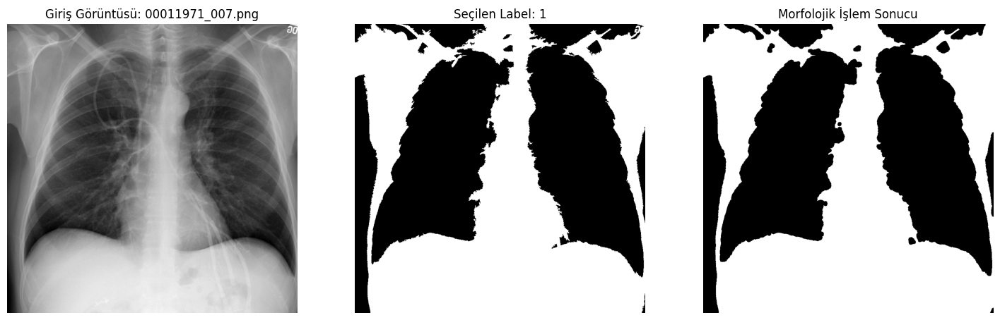

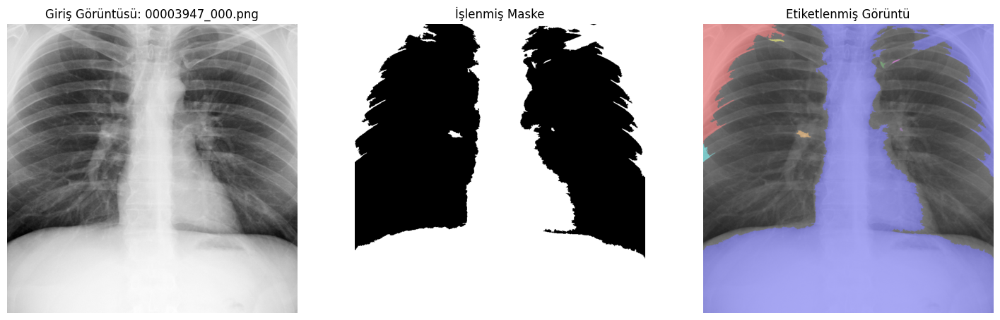

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00003947_000.png
Seçilen Label: 2, Alan: 328015.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00003947_000.png

İşleniyor: 00000640_001.png
Bağlantı bileşen analizi sonucunda toplam 11 bölge bulundu.

Bölge Özellikleri (00000640_001.png):
Bölge 1:
  Area: 493374.0
  Centroid: (436.13595365787415, 393.0992431704954)
  Eccentricity: 0.47445299171108357
  Perimeter: 11517.779864150187
  Mean Intensity: 184.9339973326523
Bölge 2:
  Area: 111.0
  Centroid: (170.80180180180182, 492.0450450450451)
  Eccentricity: 0.7876543534962919
  Perimeter: 46.04163056034261
  Mean Intensity: 157.95495495495496
Bölge 3:
  Area: 89.0
  Centroid: (174.22471910112358, 459.59550561797755)
  Eccentricity: 0.7815670700171569
  Perimeter: 55.45584412271571
  Mean Intensity: 157.6067415730337
Bölge 4:
  Area: 55.0
  Centroid: (230.6727272727273, 289.3272727272727)
  Eccentricity: 0.8530793266319866
  Perimeter: 29.14213562373094

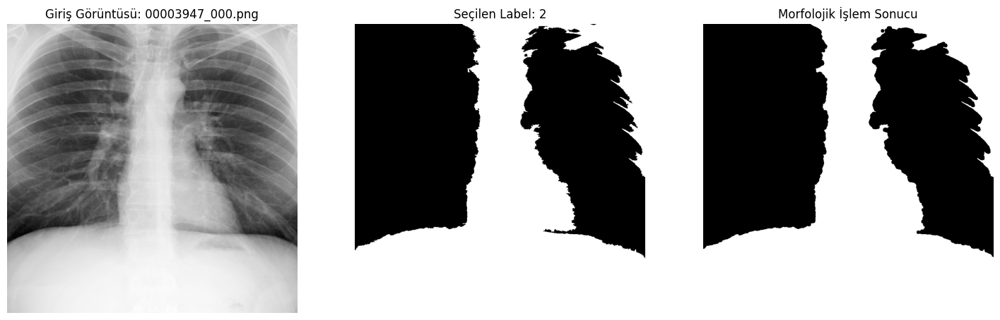

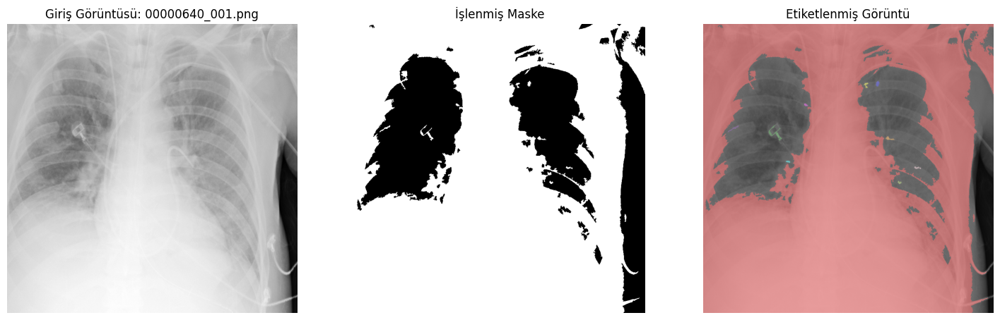

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00000640_001.png
Seçilen Label: 1, Alan: 493374.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00000640_001.png

İşleniyor: 00003034_000.png
Bağlantı bileşen analizi sonucunda toplam 3 bölge bulundu.

Bölge Özellikleri (00003034_000.png):
Bölge 1:
  Area: 362191.0
  Centroid: (536.4591279186948, 397.1320573951313)
  Eccentricity: 0.6288884728447599
  Perimeter: 6922.520487134642
  Mean Intensity: 187.68061050661115
Bölge 2:
  Area: 23745.0
  Centroid: (150.73409138766056, 776.2092229943146)
  Eccentricity: 0.9576494721255036
  Perimeter: 1831.6042558696058
  Mean Intensity: 157.72453148031164
Bölge 3:
  Area: 67.0
  Centroid: (525.5522388059702, 754.3582089552239)
  Eccentricity: 0.9141707902082394
  Perimeter: 47.97056274847714
  Mean Intensity: 129.92537313432837


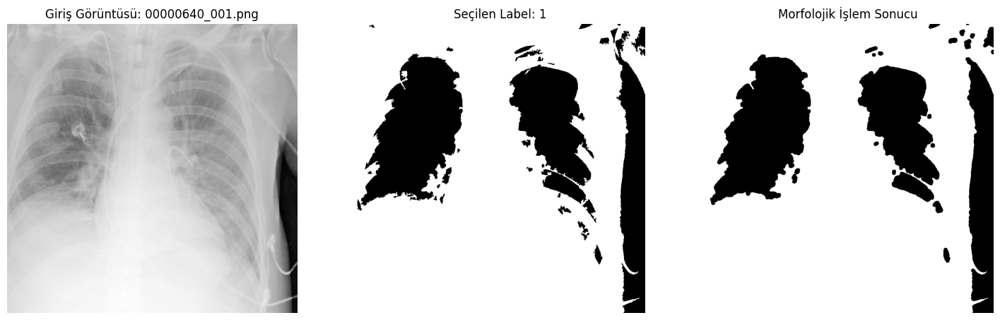

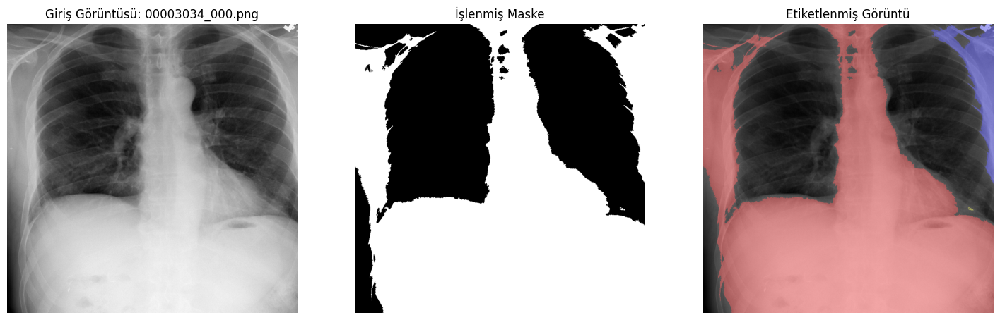

Etiketlenmiş görüntü kaydedildi: /content/labelling_images/labeled_00003034_000.png
Seçilen Label: 1, Alan: 362191.0
İşlenmiş görüntü kaydedildi: /content/processed_images/morphed_00003034_000.png


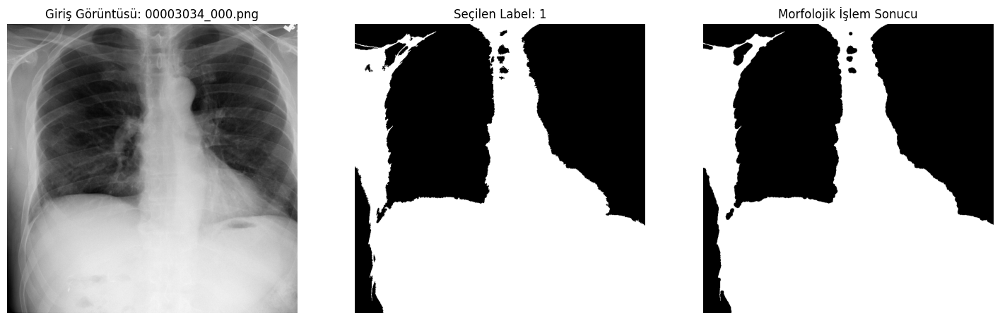

In [ ]:
input_folder = "/content/cropping_images"

output_label_folder = "/content/labelling_images"
output_morphed_folder = "/content/processed_images"
os.makedirs(output_label_folder, exist_ok=True)  # Etiketlenmiş görüntüler için klasör oluştur
os.makedirs(output_morphed_folder, exist_ok=True)  # Morfolojik işlem sonuçları için klasör oluştur

if os.path.exists(output_morphed_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_morphed_folder):
        file_path = os.path.join(output_morphed_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_morphed_folder)

if os.path.exists(output_label_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_label_folder):
        file_path = os.path.join(output_label_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_label_folder)

# Structural Element Tipi ve Boyutu
structural_element = disk(5)  # Disk şeklinde, yarıçapı 5 olan yapısal eleman

# Klasördeki görüntü dosyalarını listele
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

# Görüntüler üzerinde işlem yap
for image_name in image_files:
    print(f"\nİşleniyor: {image_name}")
    image_path = os.path.join(input_folder, image_name)

    # Görüntüyü gri tonlamalı olarak yükle
    image = io.imread(image_path, as_gray=True)

    # Thresholding ve morfolojik işlemler
    threshold = filters.threshold_otsu(image)
    binary_mask = image > threshold

    # Küçük nesneleri ve delikleri kaldırma
    cleaned_mask = morphology.remove_small_objects(binary_mask, min_size=50)
    cleaned_mask = morphology.remove_small_holes(cleaned_mask, area_threshold=50)

    # Bağlantı bileşen analizi (CCL)
    labeled_image = measure.label(cleaned_mask)
    num_regions = labeled_image.max()  # Toplam bölge sayısı
    print(f"Bağlantı bileşen analizi sonucunda toplam {num_regions} bölge bulundu.")

    # Bölge özelliklerini çıkarma
    properties = measure.regionprops(labeled_image, intensity_image=image)
    print(f"\nBölge Özellikleri ({image_name}):")
    for i, prop in enumerate(properties):
        print(f"Bölge {i+1}:")
        print(f"  Area: {prop.area}")
        print(f"  Centroid: {prop.centroid}")
        print(f"  Eccentricity: {prop.eccentricity}")
        print(f"  Perimeter: {prop.perimeter}")
        print(f"  Mean Intensity: {prop.mean_intensity}")

    # Etiketlenmiş görüntüyü oluştur
    labeled_overlay = label2rgb(labeled_image, image=image, bg_label=0)

    # Görselleştirme: Etiketlenmiş görüntü
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title(f"Giriş Görüntüsü: {image_name}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(cleaned_mask, cmap='gray')
    plt.title("İşlenmiş Maske")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(labeled_overlay)
    plt.title("Etiketlenmiş Görüntü")
    plt.axis('off')

    # Görselleri kaydetme
    labeled_image_path = os.path.join(output_label_folder, f"labeled_{image_name}")
    plt.savefig(labeled_image_path, bbox_inches='tight', pad_inches=0)
    plt.show()
    plt.close()
    print(f"Etiketlenmiş görüntü kaydedildi: {labeled_image_path}")

    # En büyük bölgeyi seçme
    selected_label = None
    max_area = 0
    for prop in properties:
        if prop.area > max_area:
            max_area = prop.area
            selected_label = prop.label

    if selected_label is None:
        print("Hiçbir geçerli label bulunamadı.")
        continue

    print(f"Seçilen Label: {selected_label}, Alan: {max_area}")

    # Seçilen labela uygun maske oluştur
    selected_mask = (labeled_image == selected_label)

    # Morfolojik işlemler (Örnek: dilasyon ve ardından erosion - closing)
    morphed_mask = morphology.dilation(selected_mask, footprint=structural_element)
    morphed_mask = morphology.erosion(morphed_mask, footprint=structural_element)


    # Görselleştirme: Morfolojik işlem uygulanmış görüntü
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(image, cmap='gray')
    plt.title(f"Giriş Görüntüsü: {image_name}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(selected_mask, cmap='gray')
    plt.title(f"Seçilen Label: {selected_label}")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(morphed_mask, cmap='gray')
    plt.title("Morfolojik İşlem Sonucu")
    plt.axis('off')

    # Görselleri kaydetme
    morphed_image_path = os.path.join(output_morphed_folder, f"morphed_{image_name}")
    io.imsave(morphed_image_path, morphed_mask.astype("uint8") * 255)  # Morfolojik sonucu kaydet
    print(f"İşlenmiş görüntü kaydedildi: {morphed_image_path}")

Post-processing adımlarının uygulanması. (Etiketlenmiş görüntüler labelling_images klasörüne kaydedilir. Morfolojik işlem sonuçları processed_images klasörüne kaydedilir.)

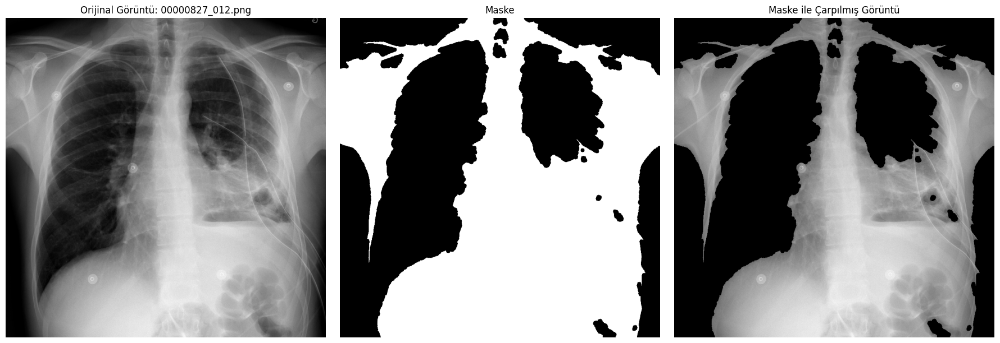

Sonuç görüntü kaydedildi: /content/output_images/masked_00000827_012.png


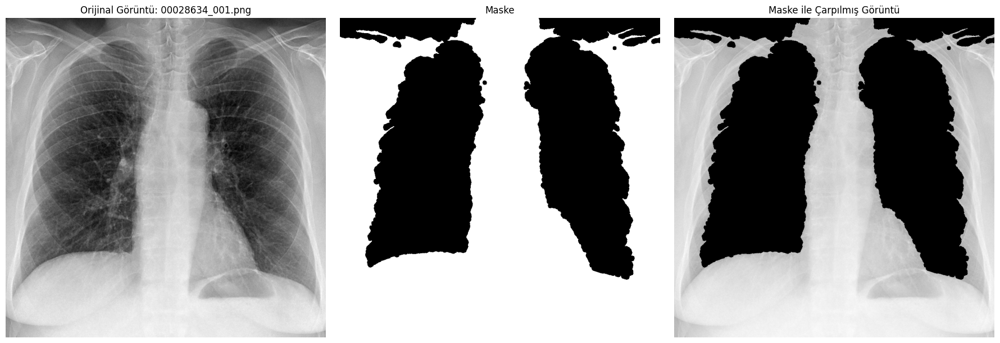

Sonuç görüntü kaydedildi: /content/output_images/masked_00028634_001.png


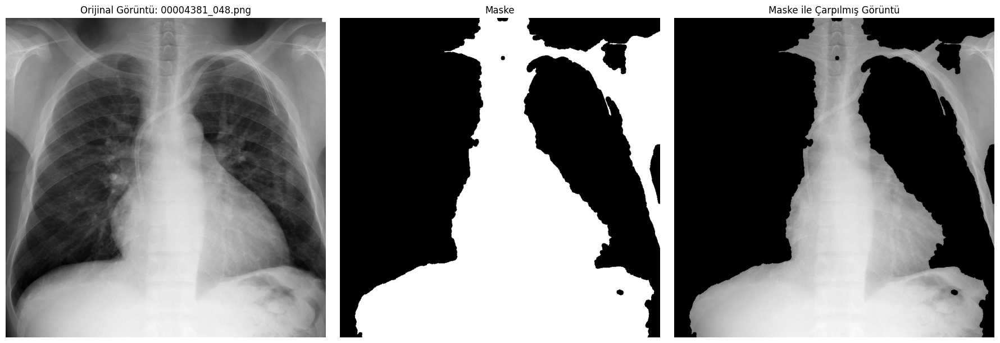

Sonuç görüntü kaydedildi: /content/output_images/masked_00004381_048.png


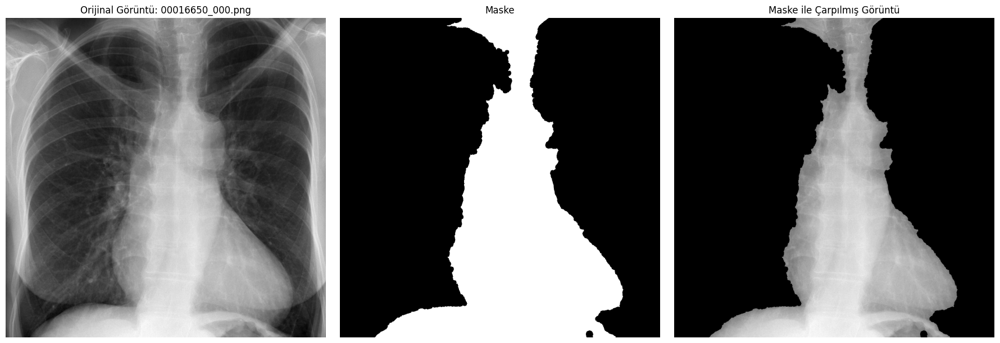

Sonuç görüntü kaydedildi: /content/output_images/masked_00016650_000.png


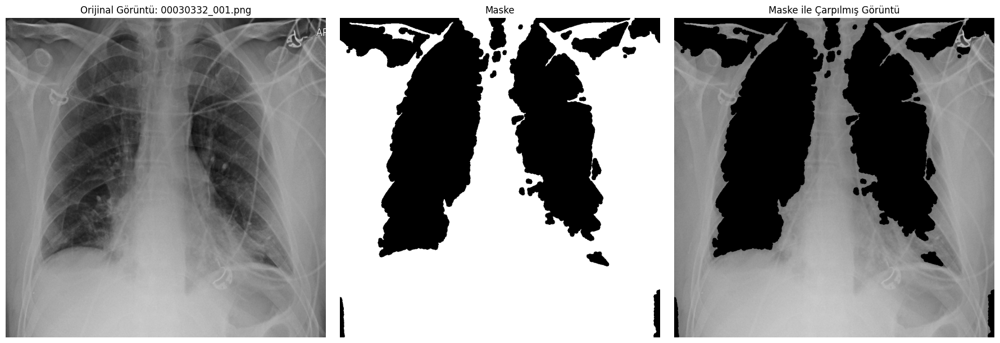

Sonuç görüntü kaydedildi: /content/output_images/masked_00030332_001.png


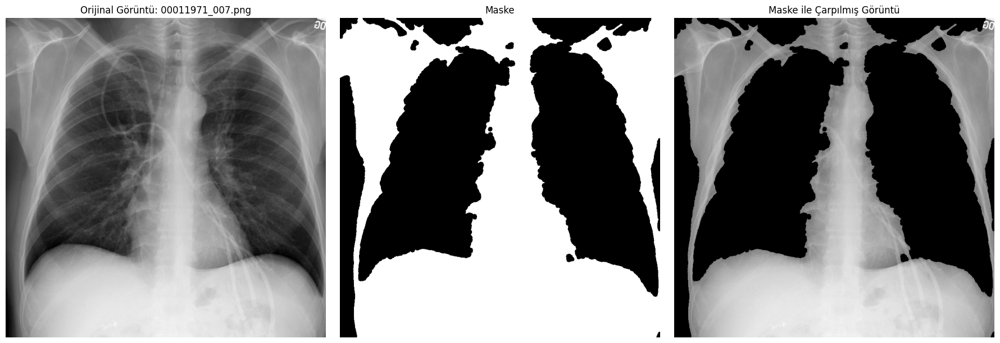

Sonuç görüntü kaydedildi: /content/output_images/masked_00011971_007.png


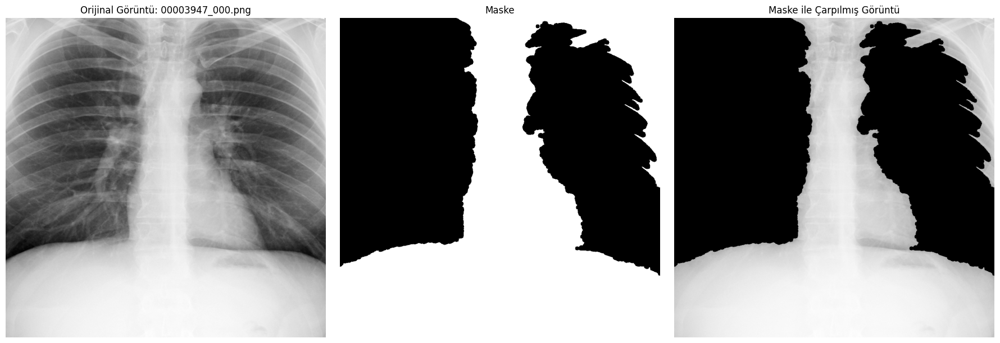

Sonuç görüntü kaydedildi: /content/output_images/masked_00003947_000.png


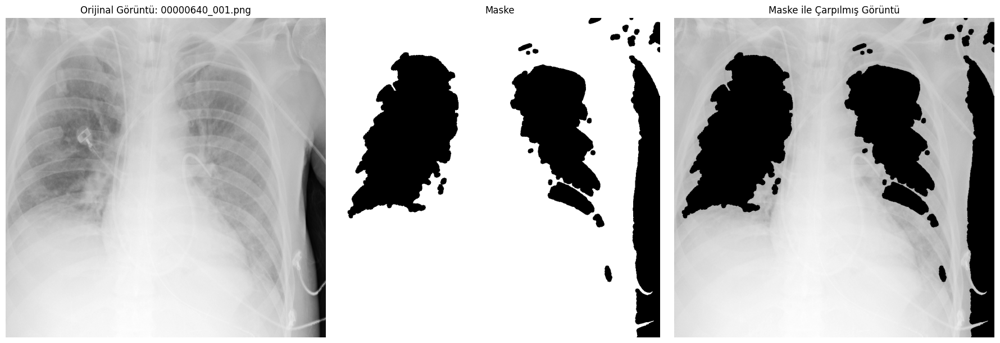

Sonuç görüntü kaydedildi: /content/output_images/masked_00000640_001.png


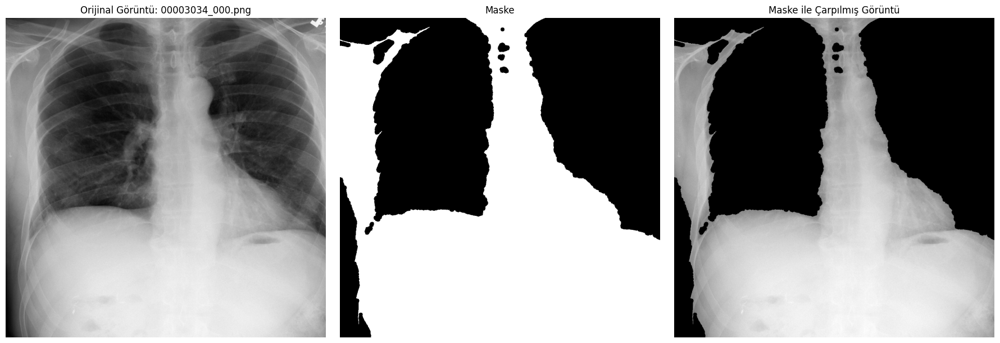

Sonuç görüntü kaydedildi: /content/output_images/masked_00003034_000.png


In [ ]:
# İşlem yapılacak orijinal görüntülerin olduğu klasör
input_folder = "/content/cropping_images"

# Maskelerin olduğu klasör
mask_folder = "/content/processed_images"

# Çarpım görüntülerinin kaydedileceği klasör
output_folder = "/content/output_images"
os.makedirs(output_folder, exist_ok=True)

if os.path.exists(output_folder):
    # Klasör içerisindeki tüm dosyaları sil
    for file in os.listdir(output_folder):
        file_path = os.path.join(output_folder, file)
        if os.path.isfile(file_path):
            os.remove(file_path)
else:
    # Klasörü oluştur
    os.makedirs(output_folder)
# Klasördeki tüm görüntüleri listele
image_files = [f for f in os.listdir(input_folder) if f.endswith(('.jpg', '.png', '.jpeg'))]

for image_name in image_files:
    # Orijinal görüntüyü yükleme
    image_path = os.path.join(input_folder, image_name)
    original_image = io.imread(image_path, as_gray=True)

    # Maskeyi yükleme
    mask_path = os.path.join(mask_folder, f"morphed_{image_name}")
    if not os.path.exists(mask_path):
        print(f"Maske bulunamadı: {mask_path}")
        continue
    mask = io.imread(mask_path, as_gray=True)

    # Maskeyi binary hale getirme
    binary_mask = mask > 0.5

    # Orijinal görüntü ile maskeyi çarpma
    processed_image = original_image * binary_mask

    # Görselleştirme
    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(original_image, cmap='gray')
    plt.title(f"Orijinal Görüntü: {image_name}")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(binary_mask, cmap='gray')
    plt.title("Maske")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(processed_image, cmap='gray')
    plt.title("Maske ile Çarpılmış Görüntü")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Çıktıyı kaydetme
    output_image_path = os.path.join(output_folder, f"masked_{image_name}")
    io.imsave(output_image_path, (processed_image * 255).astype('uint8'))
    print(f"Sonuç görüntü kaydedildi: {output_image_path}")


İşlemler sonucunda elde ettiğimiz maske ile orijinal görüntüyü çarparak görüntü işleme sonuçlarının görselleştirilmesi.